# PROJECT PGM: 2023-2024
# Independent component analysis: algorithms and applications

Kelthoum KERBOUA: kelthoum.kerboua@telecom-paris.fr

Fatima BALDE: fatima.balde@telecom-paris.fr

## Import

In [ ]:
!pip install mne

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 17.3 MB/s eta 0:00:00


In [ ]:
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import os
from scipy import linalg as LA
import mne
from mne.preprocessing import corrmap, create_ecg_epochs, create_eog_epochs
from scipy.io import loadmat
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import librosa
from IPython.display import Audio, display
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn import datasets
from sklearn.datasets import load_digits
import tensorflow as tf
from sklearn.datasets import make_circles
from scipy.spatial.distance import pdist,squareform

## Implementation of FastICA

In [ ]:
def center_data(X):
  """
    Returns the centered array (mean according to axis 1 equal to 0)
            Parameters:
              X (array)
            Returns:
              Xc (array): centered array
              mean (array): mean according to axis 1
  """

  mean = np.mean(X, axis=1, keepdims=True)
  return X - mean, mean

def whiten_data(X):
    """
    Returns the whitened array (covariance equal to the identity matrix)
            Parameters:
              Xc (array): centered array
            Returns:
              X (array): whitened array
              X_white_inv (array): inverse of the whitening matrix
    """

    cov_matrix = np.cov(X)
    D, P = np.linalg.eigh(cov_matrix)
    D_inv = np.diag(1.0 / np.sqrt(np.abs(D)))
    X_white = np.dot(np.dot(P, D_inv), P.T)
    return np.dot(X_white, X), np.linalg.inv(X_white)


def FastICA(X_, n_components, function_g="tanh", tol=10e-4, max_iter=200):

    """
    Returns the mixing matrix and the sources, outputs of FastICA algorithm
            Parameters:
                 X (array)
                 n_components (int): number of sources
                 function_g (string): choice of the function g (derivative of the non-quadratic function G used in the approximation to neg-entropy)
                 tol (float): tolerance for the convergence of the mixing matrix
                 max_iter (int): maximum of iterations for the computation of the mixing matrix column
            Returns:
                 W (array): mixing matrix
                 S (array): sources
                 X_white_inv (array): inverse of the whitening matrix
                 mean (array): mean according to axis 1


    """

    # define choices of g
    # choice 1 of g and g'
    def tanh_(x):
        return np.tanh(x)
    def tanh_prime(x):
        return 1 - np.square(np.tanh(x))
    #choice 2 of g and g'
    def exp_(x):
        return x*np.exp(-x**2/2)
    def exp_prime(x):
        return (1-x**2)*np.exp(-x**2/2)

    # initialization of W
    n,m=X_.shape
    W = np.random.rand(n_components, n)
    W_norms=np.linalg.norm(W, axis=1, keepdims=True)
    W=W/W_norms

    # choice of g
    if function_g == "tanh":
            g = tanh_
            gprime= tanh_prime
    elif function_g == "exp":
            g= exp_
            gprime= exp_prime

    # center and whiten data
    X, mean =center_data(X_)
    X, X_white_inv =whiten_data(X)

    for j in range(n_components):
        #initialization of the component j
        w = W[j, :].copy()
        i=0
        convergence=tol+1
        while i<max_iter and convergence >= tol:
            #update w
            old_w=w.copy()
            w = np.mean(X*(g(np.dot(w.T, X))), axis=1) - (np.mean((gprime(np.dot(w.T, X))),axis=0)*w)

            #decorrelation
            w-= np.dot(np.dot(w, W[:j].T),W[:j])
            w/= np.sqrt((w**2).sum())

            #convergence: we check that the old and new values of w point in the same direction
            convergence = np.abs(np.abs(np.dot(w,old_w.T)) - 1)
            i+=1
        W[j, :] = w

    S= np.dot(W,X)
    W =np.dot(W,X_white_inv)
    return W, S, X_white_inv, mean


## Simple Examples

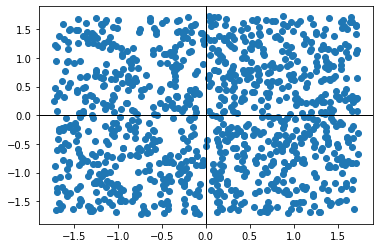

In [ ]:
def random_uniform(nb_points):
  s1 = np.random.uniform(-np.sqrt(3), np.sqrt(3), nb_points)
  s2 = np.random.uniform(-np.sqrt(3), np.sqrt(3), nb_points)
  return s1,s2

#Define source s1 and s2 with uniform distribution
nb_points=1000
s1,s2=random_uniform(nb_points)
plt.figure()
plt.scatter(s1,s2)
plt.axhline(0, color='black',linewidth=1)
plt.axvline(0, color='black',linewidth=1)
plt.show()

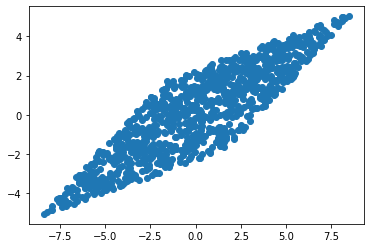

In [ ]:
#Define mixtures of s1 and s2
Mixing_matrix=np.array([[2,3],[2,1]])
Mixed_values=Mixing_matrix@np.array([s1,s2])
plt.figure()
plt.scatter(Mixed_values[0,:],Mixed_values[1,:])
plt.show()

In [ ]:
#Estimation of the sources and the mixing matrix with FastICA
W,S, _, _ =FastICA(Mixed_values, 2, function_g="tanh", tol=10e-4, max_iter=200)

In [ ]:
print("Estimated Mixing Matrix:", W.T)
print("True Mixing Matrix:", Mixing_matrix)

Estimated Mixing Matrix: [[ 2.19140354 -2.95121658]
 [ 2.04888315 -0.97305151]]
True Mixing Matrix: [[2 3]
 [2 1]]


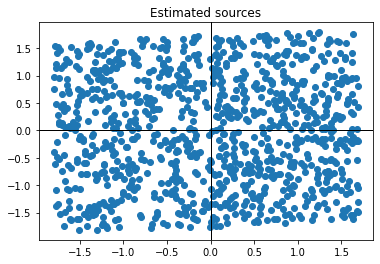

In [ ]:
#Plot the estimated source
plt.figure()
plt.scatter(S[0,:],S[1,:])
plt.axhline(0, color='black',linewidth=1)
plt.axvline(0, color='black',linewidth=1)
plt.title("Estimated sources")
plt.show()

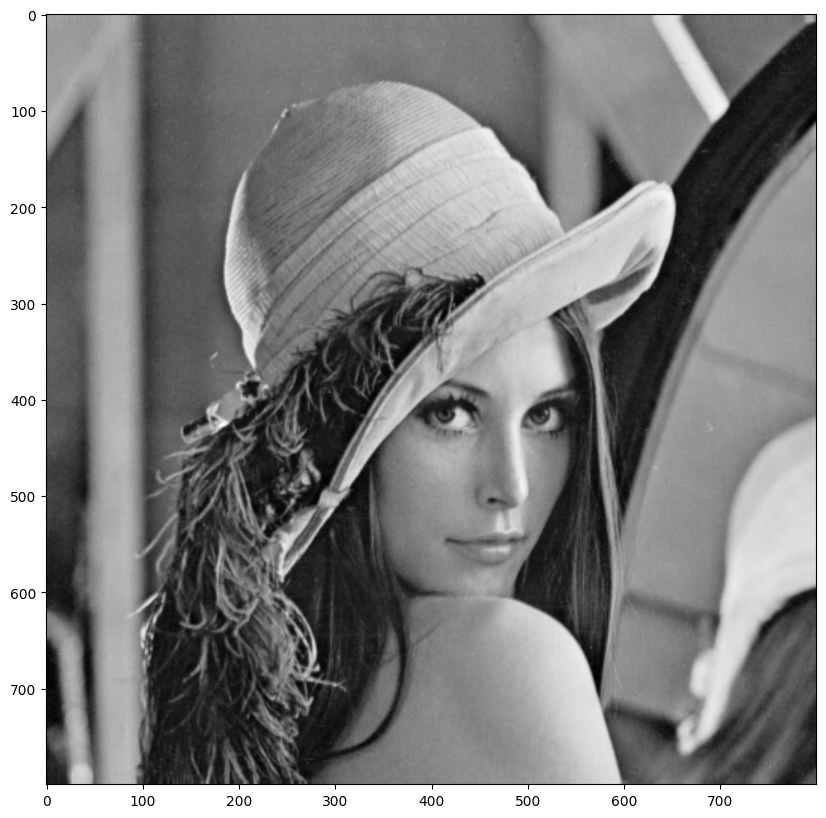

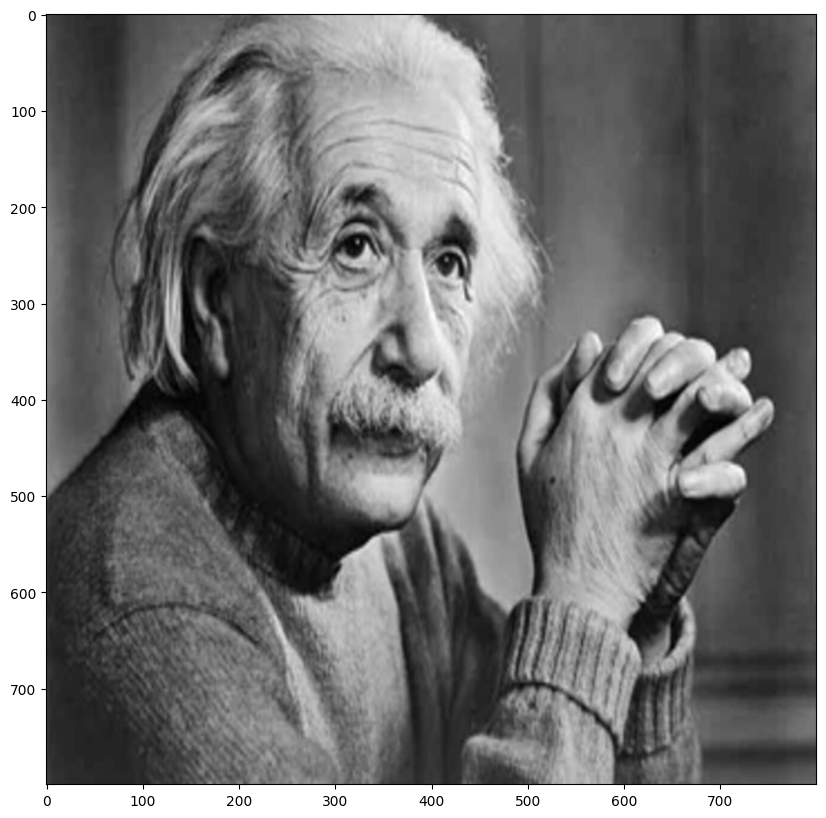

In [ ]:
#Import 2 gray images (lena and albert)
image_couleur1 = cv.imread('lena.tif')
image_couleur2 = cv.imread('albert.tif')
new_size = (800, 800)
image_couleur1 = cv.resize(image_couleur1, new_size)
image_couleur2 = cv.resize(image_couleur2, new_size)
image_gris1 = cv.cvtColor(image_couleur1, cv.COLOR_BGR2GRAY)
image_gris2 = cv.cvtColor(image_couleur2, cv.COLOR_BGR2GRAY)
plt.figure(figsize=(10,10))
plt.imshow(image_gris1,cmap='gray')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow(image_gris2,cmap='gray')
plt.show()

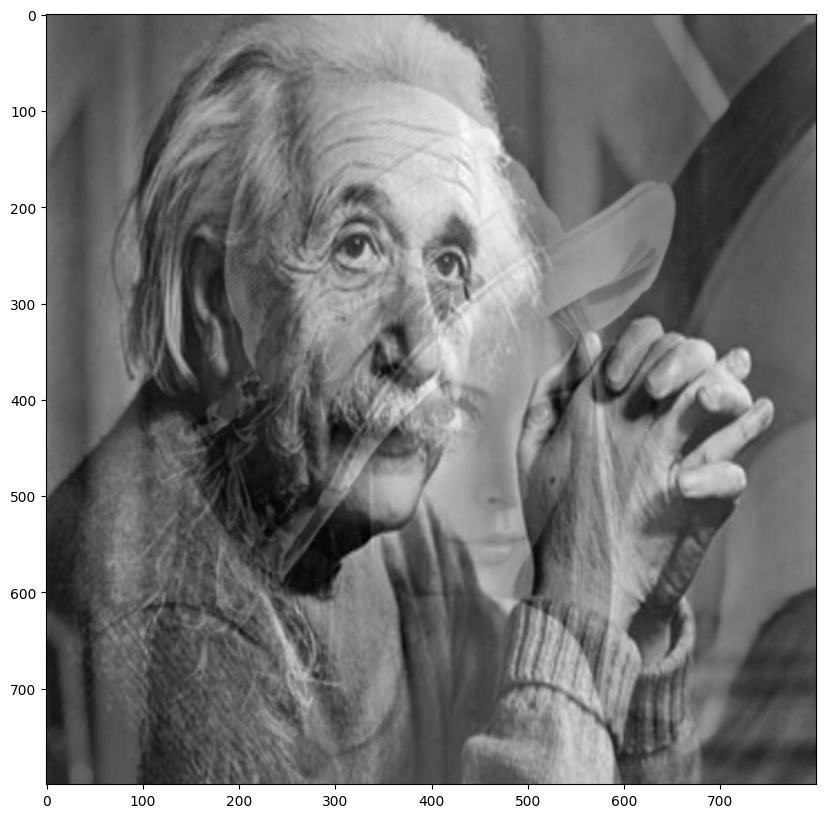

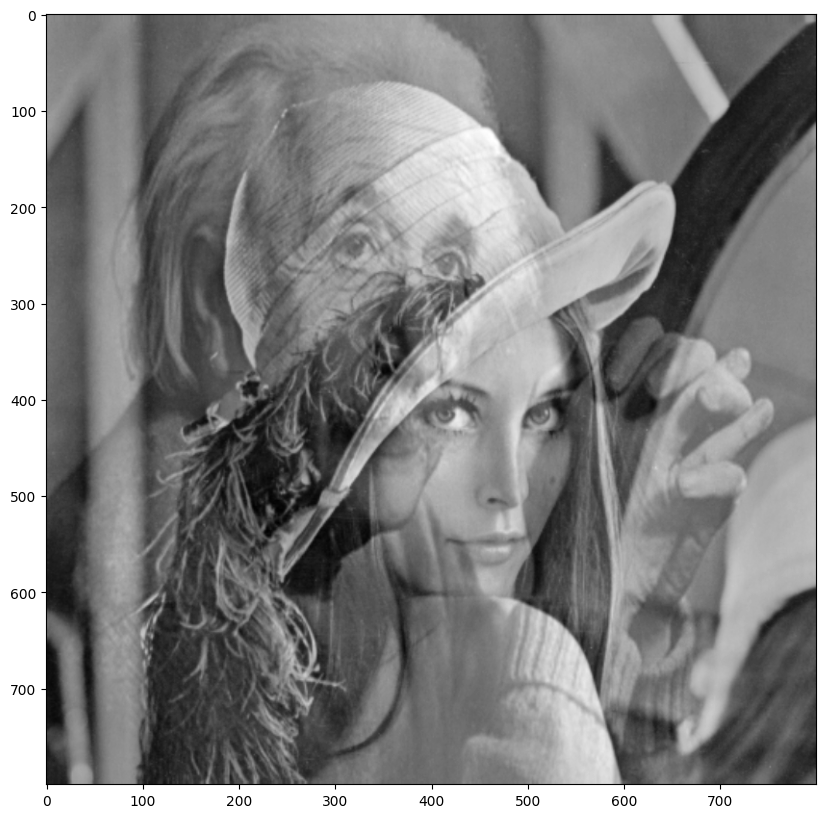

In [ ]:
#Define mixtures of the images lena and albert
Mixed_image1=0.5*image_gris1+0.9*image_gris2
Mixed_image2=0.9*image_gris1+0.4*image_gris2
plt.figure(figsize=(10,10))
plt.imshow(Mixed_image1,cmap='gray')
plt.figure(figsize=(10,10))
plt.imshow(Mixed_image2,cmap='gray')

In [ ]:
#extraction of the original images with FastICA
Mixed_images=np.array([Mixed_image1.flatten(), Mixed_image2.flatten()])
W,S, _,_ =FastICA(Mixed_images, 2, function_g="tanh", tol=10e-4, max_iter=200)

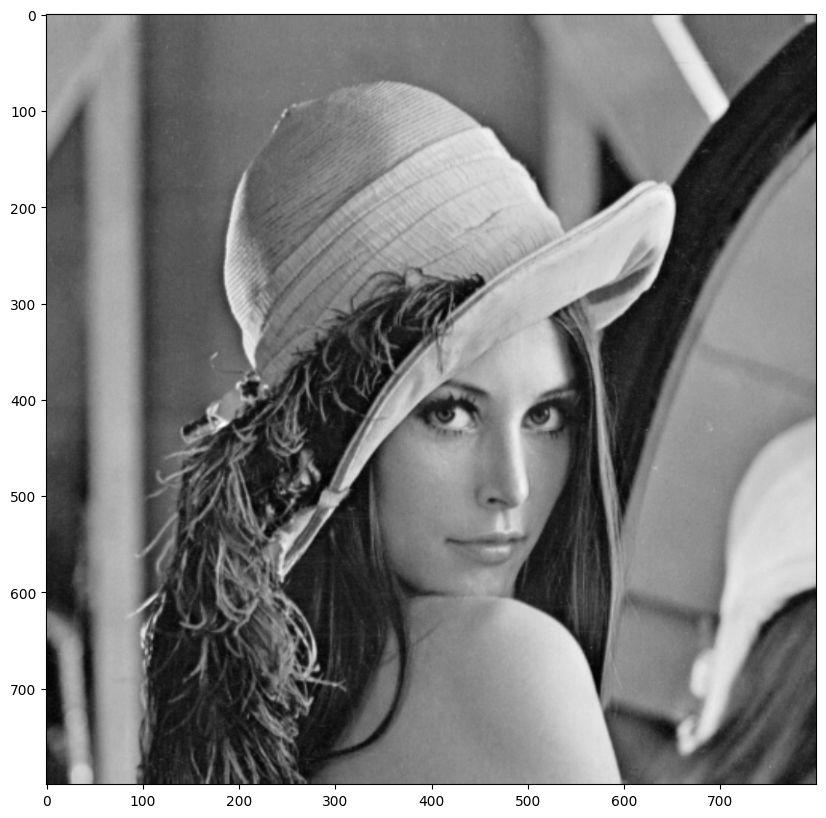

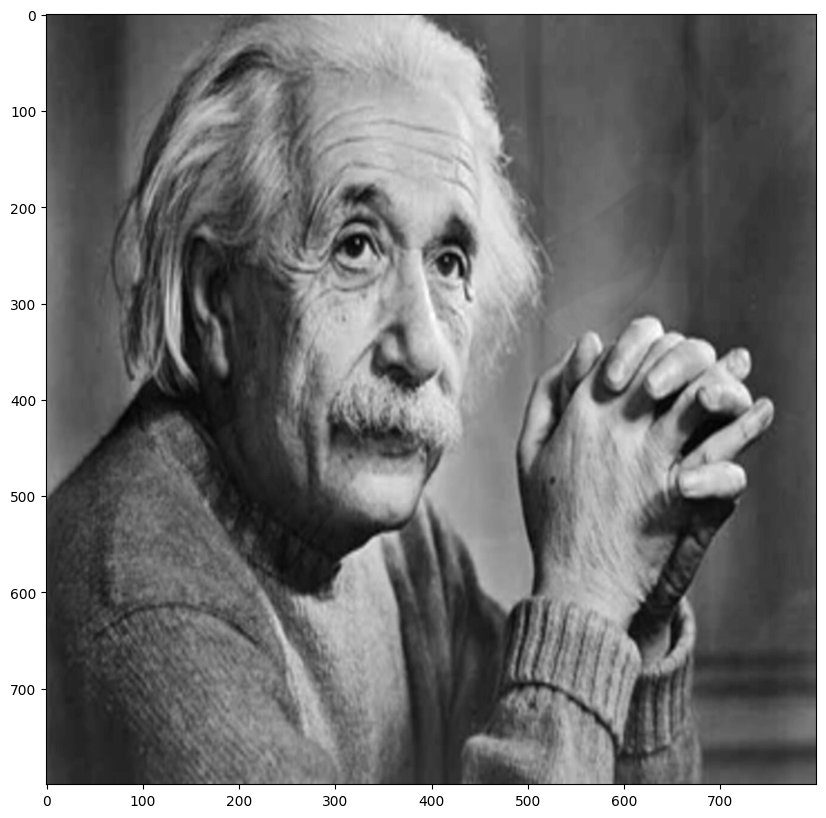

In [ ]:
#Plot the estimated images
Estimated_image1=S[0,:].reshape(new_size)
Estimated_image2=S[1,:].reshape(new_size)
plt.figure(figsize=(10,10))
plt.imshow(Estimated_image1,cmap='gray')
plt.figure(figsize=(10,10))
plt.imshow(Estimated_image2,cmap='gray')

(-0.5, 799.5, 799.5, -0.5)

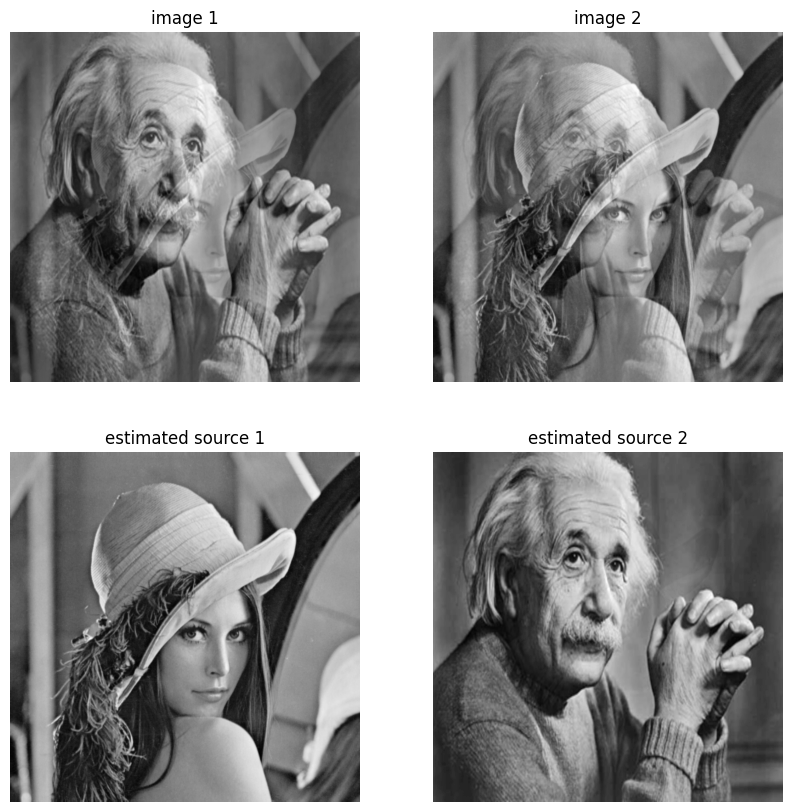

In [ ]:
fig, axs = plt.subplots(2, 2, figsize=(10,10))
axs[0, 0].imshow(Mixed_image1, cmap='gray')
axs[0, 0].set_title("image 1")
axs[0, 0].axis('off')
axs[0, 1].imshow(Mixed_image2, cmap='gray')
axs[0, 1].set_title("image 2")
axs[0, 1].axis('off')
axs[1, 0].imshow(Estimated_image1, cmap='gray')
axs[1, 0].set_title("estimated source 1")
axs[1, 0].axis('off')
axs[1, 1].imshow(Estimated_image2, cmap='gray')
axs[1, 1].set_title("estimated source 2")
axs[1, 1].axis('off')

## Reducing noise in natural images

### Classical method

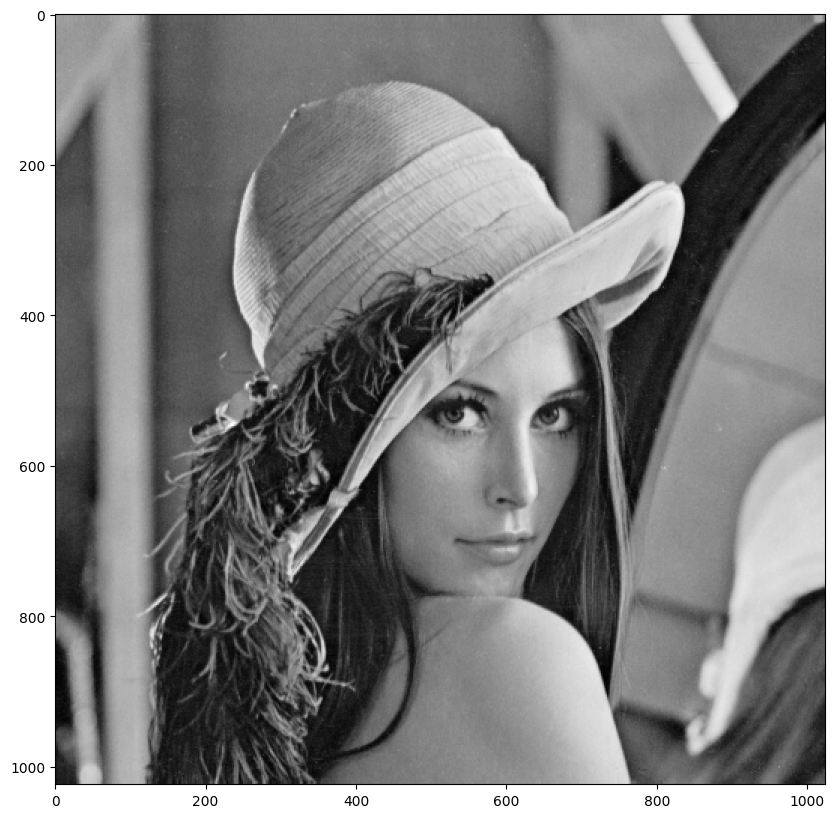

In [ ]:
#Import the gray image lena
image_couleur = cv.imread('lena.tif')
image_gris = cv.cvtColor(image_couleur, cv.COLOR_BGR2GRAY)
enlargement_factor=2
image_gris= np.repeat(np.repeat(image_gris, enlargement_factor, axis=0), enlargement_factor, axis=1)
plt.figure(figsize=(10,10))
plt.imshow(image_gris, cmap='gray')
plt.show()

In [ ]:
def add_noise(image,sigma):
    """
    Returns the image with a gaussian noise
            Parameters:
                 image (array)
                 sigma (float): variance of the gaussian noise
            Returns:
                  noisy_image (array)
    """
    rows, cols = image.shape
    noise = np.random.normal(0, sigma, (rows, cols))
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

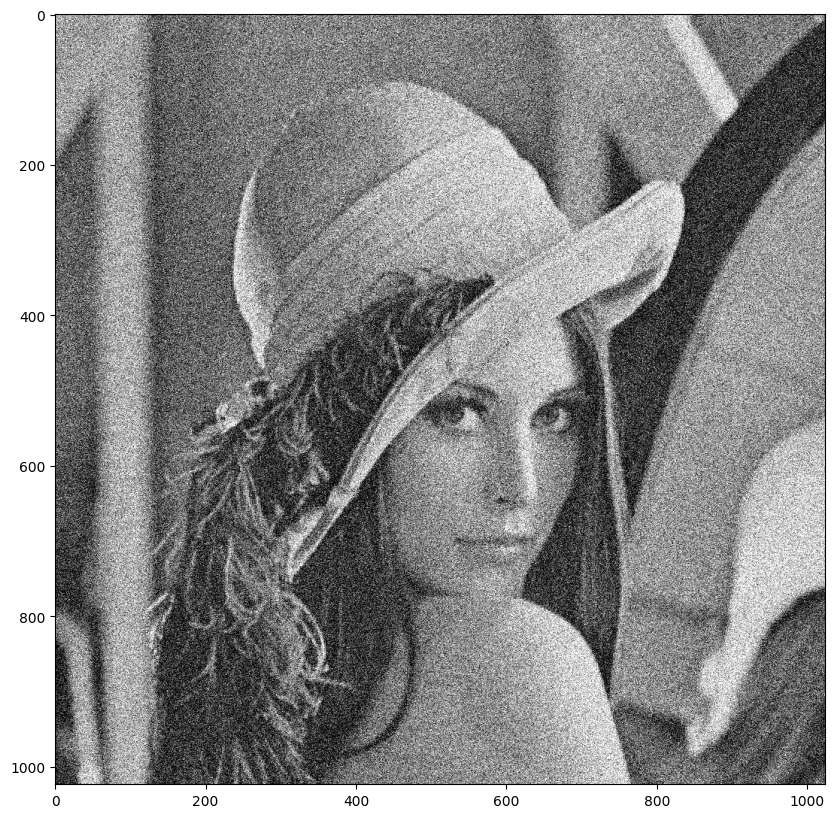

In [ ]:
#Add gaussian noise (variance equal to 50) to lena image
sigma=50
noisy_image=add_noise(image_gris, sigma)
plt.figure(figsize=(10,10))
plt.imshow(noisy_image, cmap='gray')
plt.show()

In [ ]:
def extract_patches(noisy_image,patch_size):
    """
    Returns an array with the flattened patches of the image
            Parameters:
                 image (array)
                 patch_size (int): size of the patches
            Returns:
                  patches (array): array with the flattened patches
    """
    height, width = noisy_image.shape

    # Computation of the number of patches in height and width
    num_patches_h = height // patch_size
    num_patches_w = width // patch_size

    # Initialize the list of patches
    patches = []

    # Extraction of patches
    for i in range(num_patches_h):
        for j in range(num_patches_w):
            patch = noisy_image[i * patch_size:min((i + 1) * patch_size,height), j * patch_size:min((j + 1) * patch_size,width)]
            patches.append(patch.flatten())
    return np.array(patches)

In [ ]:
def g(y,std): #shrinkage_function
    """
    Returns the value of the shrinkage function at point y
            Parameters:
                 y (float)
                 std (float): standard deviation of the noise (parameter of the shrinkage function)
            Returns:
                  g (float)
    """
    # we estimate the noise variance over a homogeneous area of the image
    return np.sign(y) * np.maximum(0, np.abs(y) - np.sqrt(2)*std)

In [ ]:
def compute_true_image(patches, W, std):
    """
    Returns the image after Sparse Code Shrinkage method
            Parameters:
                 patches (array): array with the flattened patches of the image
                 W (array): mixing matrix (output of FastICA algorithm)
                 std (float): standrad deviation of the gaussian noise
            Returns:
                  denoised_patches (array): patches after the shrinkage operation is performed in the rotated space
    """
    #Perform Sparse Code Shrinkage method on the patches for denoising
    S_hat = g(np.dot(W,patches),std)
    denoised_patches= np.dot(W.T,S_hat)
    return denoised_patches

In [ ]:
def reconstruct_image_from_patches(denoised_patches):
  """
  Returns the denoised image
          Parameters:
                denoised_patches (array): array with the flattened patches of the image after shrinkage operation
          Returns:
                denoised_image (array): reconstitution of the denoised image from the patches
  """

  patch_shape = int(np.sqrt(denoised_patches.shape[1]))
  num_patches = denoised_patches.shape[0]
  image_size = int(np.sqrt(num_patches) * patch_shape)

  # Initialize the denoised image
  reconstructed_image = np.zeros((image_size, image_size))

  #Repositioning of patches in the 2D image
  for i in range(num_patches):
    patch = denoised_patches[i,:].reshape((patch_shape,patch_shape))
    row_start = (i // int(np.sqrt(num_patches))) * patch_shape
    col_start = (i % int(np.sqrt(num_patches))) * patch_shape
    reconstructed_image[row_start:row_start + patch_shape, col_start:col_start + patch_shape] = patch
  return reconstructed_image

In [ ]:
def remove_noise(noisy_image, sigma, window_size, n_components):
    """
    Returns the denoised image
            Parameters:
                 noisy_image (array)
                 sigma (float): variance of the gaussian noise (we estimate the noise variance over a homogeneous area of the image)
                 window_size (int): size of the patches
                 n_components (int): number of components during the FastICA algorithm
            Returns:
                  denoised_image (array)
    """
    #Extraction of patches
    patches=extract_patches(noisy_image,window_size)
    #Estimation of mixing matrix and sources with FastICA
    W,S, _, _ =FastICA(patches.T, n_components, function_g="tanh", tol=10e-4, max_iter=200)
    #Perform Sparse Code Shrinkage method on the patches for denoising
    denoised_patches=compute_true_image(patches.T , W , sigma).T
    #Reconstitution of the 2D image with denoised patches
    denoised_image= reconstruct_image_from_patches(denoised_patches)
    return (denoised_image)

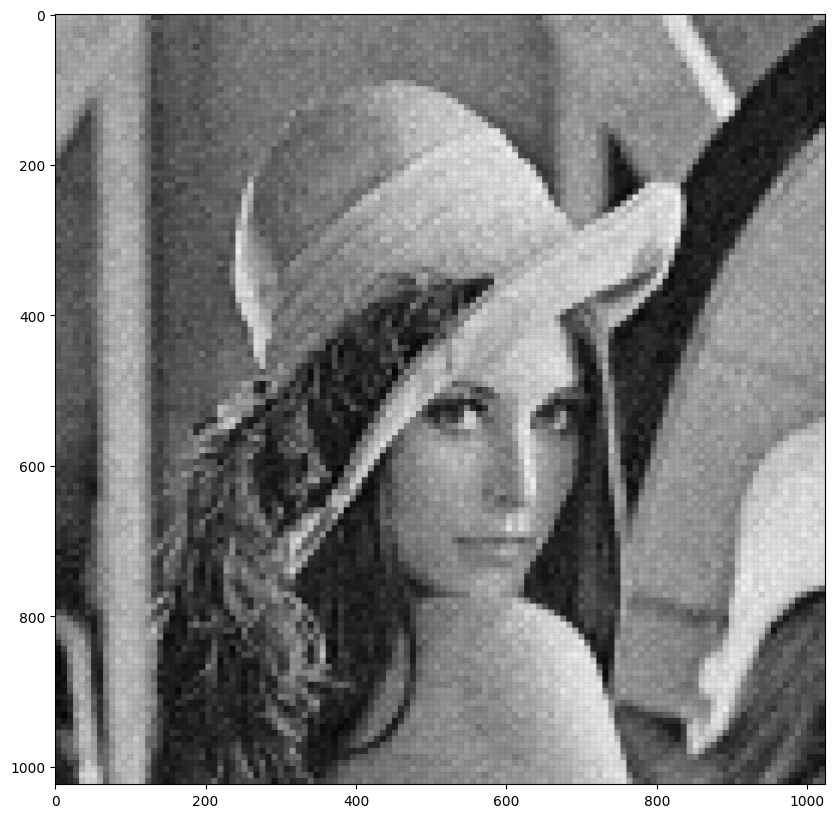

In [ ]:
#denoising the lena image with window size 8*8 and extraction of 20 sources
window_size=8
n_components=20
denoised_image = remove_noise(noisy_image, sigma, window_size, n_components)
plt.figure(figsize=(10,10))
plt.imshow(denoised_image, cmap='gray')
plt.show()

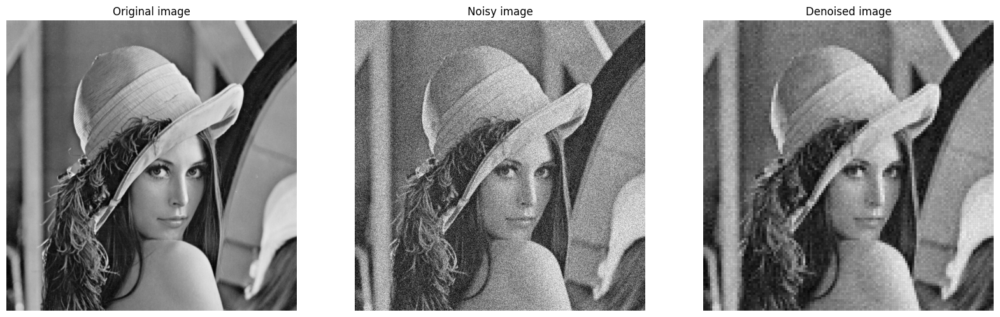

In [ ]:
#Plot original, noisy and denoised images
plt.figure(figsize=(20, 20))


plt.subplot(1, 3, 1)
plt.imshow(image_gris, cmap='gray')
plt.title("Original image")
plt.axis("off")


plt.subplot(1, 3, 2)
plt.imshow(noisy_image, cmap='gray')
plt.title("Noisy image")
plt.axis("off")


plt.subplot(1, 3, 3)
plt.imshow(denoised_image, cmap='gray')
plt.title("Denoised image")
plt.axis("off")

plt.show()

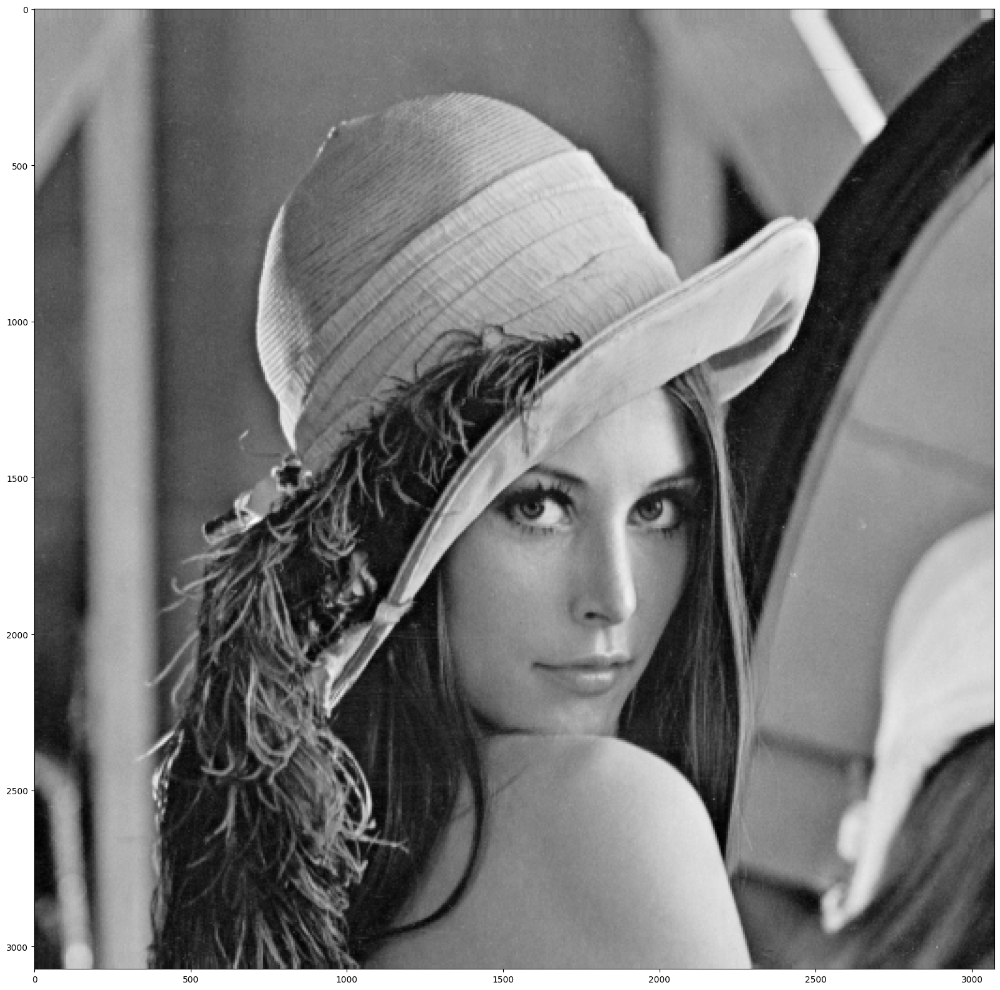

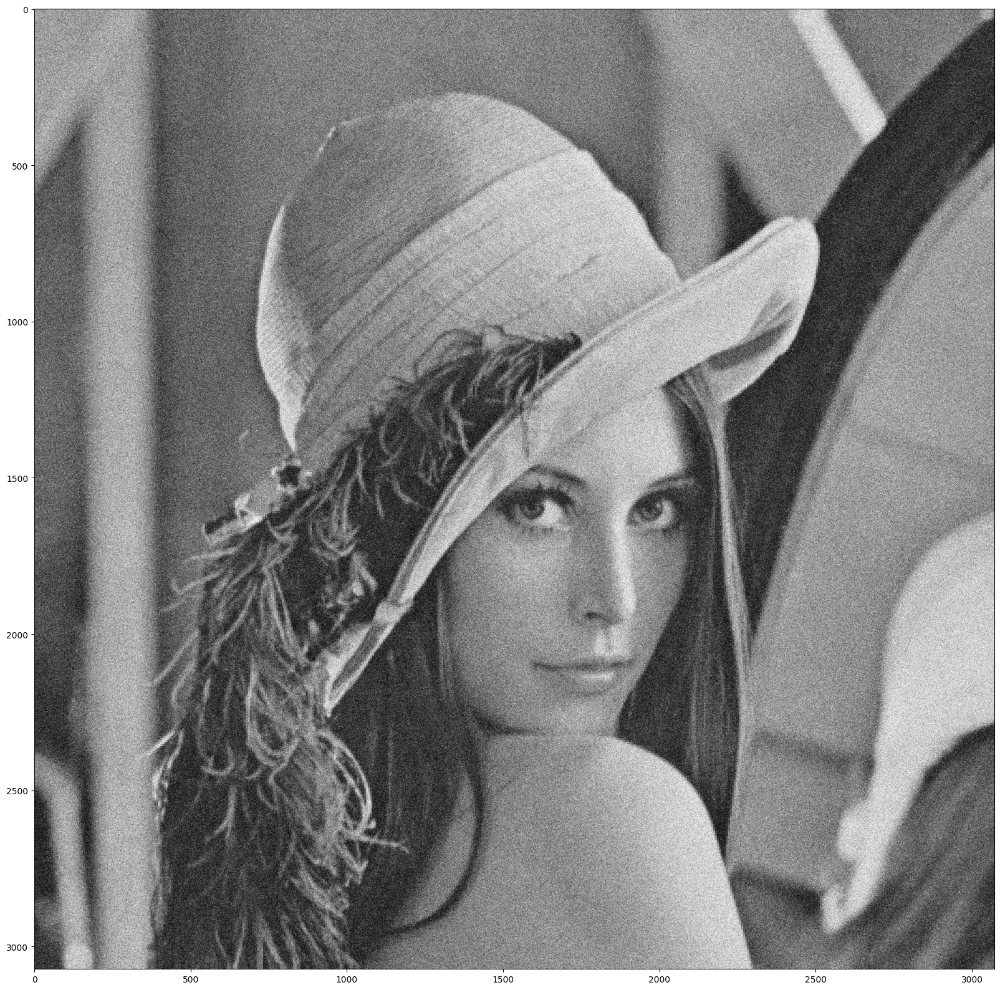

In [ ]:
#Enlarge the lena image to test the denoising method on a bigger image
enlargement_factor=6
image_gris2= np.repeat(np.repeat(image_gris, enlargement_factor, axis=0), enlargement_factor, axis=1)
plt.figure(figsize=(20,20))
plt.imshow(image_gris2, cmap='gray')
plt.show()
#Add noise to the enlarged image
sigma=50
noisy_image2=add_noise(image_gris2, sigma)
plt.figure(figsize=(20,20))
plt.imshow(noisy_image2, cmap='gray')
plt.show()

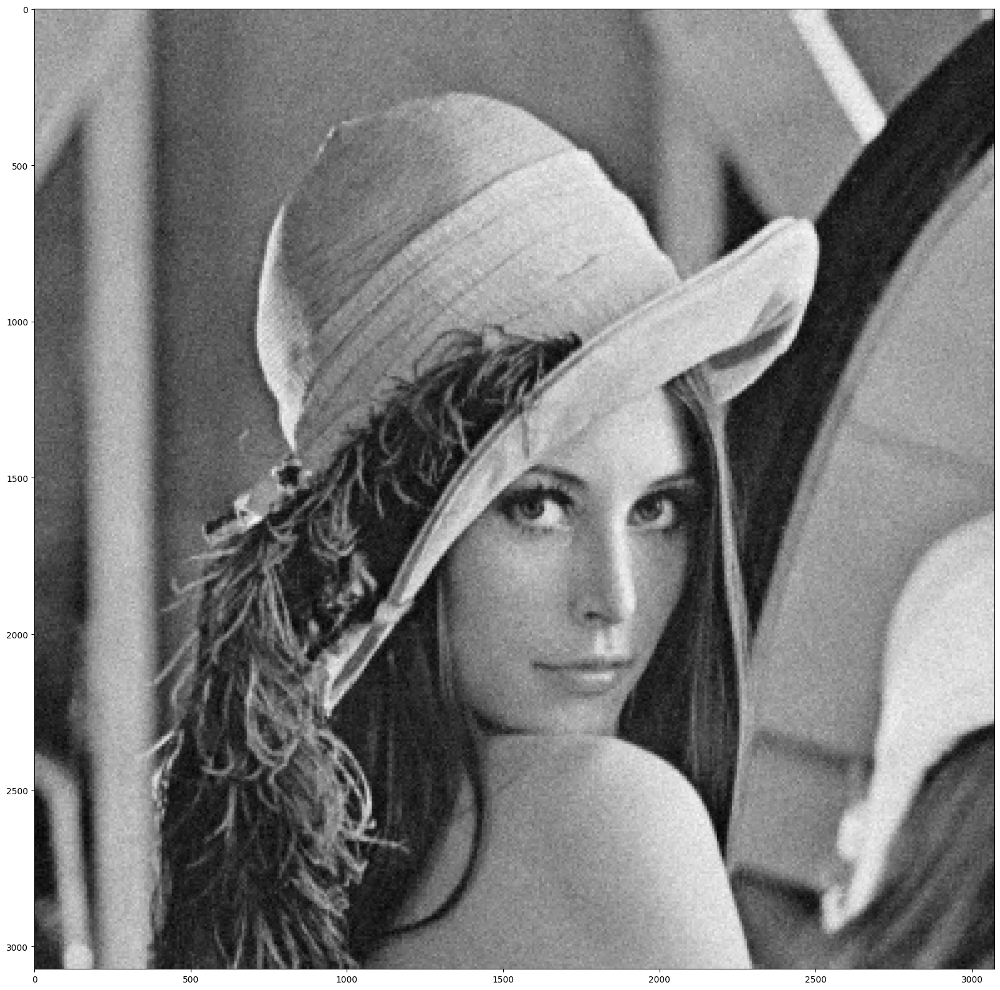

In [ ]:
#Denoise the enlarged lena image
window_size=8
n_components=20
denoised_image2 = remove_noise(noisy_image2, sigma, window_size, n_components)
plt.figure(figsize=(20,20))
plt.imshow(denoised_image2, cmap='gray')
plt.show()

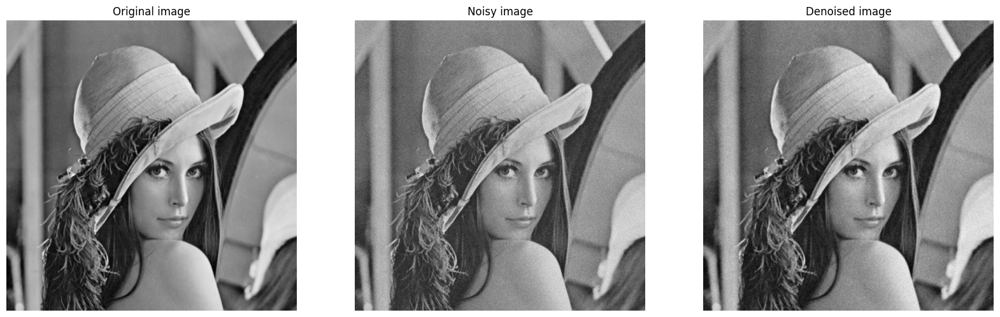

In [ ]:
#Plot original, noisy and denoised images
plt.figure(figsize=(20, 20))


plt.subplot(1, 3, 1)
plt.imshow(image_gris2, cmap='gray')
plt.title("Original image")
plt.axis("off")


plt.subplot(1, 3, 2)
plt.imshow(noisy_image2, cmap='gray')
plt.title("Noisy image")
plt.axis("off")


plt.subplot(1, 3, 3)
plt.imshow(denoised_image2, cmap='gray')
plt.title("Denoised image")
plt.axis("off")

plt.show()

### Slidding window

In [ ]:
def extract_patches_sw(noisy_image, patch_size, step=1):
    """
    Returns an array with the flattened slidding patches of the image
            Parameters:
                 image (array)
                 patch_size (int): size of the patches
                 step (int): step between two consecutive patches
            Returns:
                  patches (array): array with the flattened patches
    """
    height, width = noisy_image.shape

    #initialize the list of patches
    patches = []

    # Extraction of patches
    for i in range(0, height - patch_size + 1, step):
        for j in range(0, width - patch_size + 1, step):
            patch = noisy_image[i:i + patch_size, j:j + patch_size]
            patches.append(patch.flatten())
    return np.array(patches)

def reconstruct_image_from_patches_sw(denoised_patches, image_shape, step=1):
    """
    Returns the denoised image
            Parameters:
                 denoised_patches (array): array with the flattened slidding patches of the image after shrinkage operation
                 image_shape (tuple of int)
                 step (int): step between two consecutive patches
            Returns:
                  denoised_image (array): reconstitution of the denoised image from the patches
    """

    patch_shape = int(np.sqrt(denoised_patches.shape[1]))
    num_patches = denoised_patches.shape[0]

    #intialize the denoised image
    reconstructed_image = np.zeros(image_shape)

    row_start = 0
    col_start = 0

    #Repositioning of patches on the 2D image: We take the average of the overlapping patches for each pixel
    for i in range(num_patches):
        patch = denoised_patches[i, :].reshape((patch_shape, patch_shape))
        row_end = min(row_start + patch_shape, image_shape[0])
        col_end = min(col_start + patch_shape, image_shape[1])
        reconstructed_image[row_start:row_end, col_start:col_end] += patch

        col_start += step
        if col_start + patch_shape > image_shape[1]:
            col_start = 0
            row_start += step
    reconstructed_image/=(patch_shape/step)
    return reconstructed_image


def remove_noise_sw(noisy_image, sigma, window_size, n_components, step=1):
    """
    Returns the denoised image
            Parameters:
                 noisy_image (array)
                 sigma (float): variance of the gaussian noise (we estimate the noise variance over a homogeneous area of the image)
                 window_size (int): size of the patches
                 n_components (int): number of components during the FastICA algorithm
                 step (int): step between two consecutive patches
            Returns:
                  denoised_image (array)
    """
    #Extraction of patches from sliding windows
    patches=extract_patches_sw(noisy_image,window_size, step)
    #Estimation of mixing matrix and sources
    W,S, _, _=FastICA(patches.T, n_components, function_g="tanh", tol=10e-4, max_iter=200)
    #Perform Sparse Code Shrinkage method on the patches for denoising
    denoised_patches=compute_true_image(patches.T , W , sigma).T
    #Reconstruction of the 2D image from denoised patches
    denoised_image= reconstruct_image_from_patches_sw(denoised_patches, noisy_image.shape, step)
    return (denoised_image)

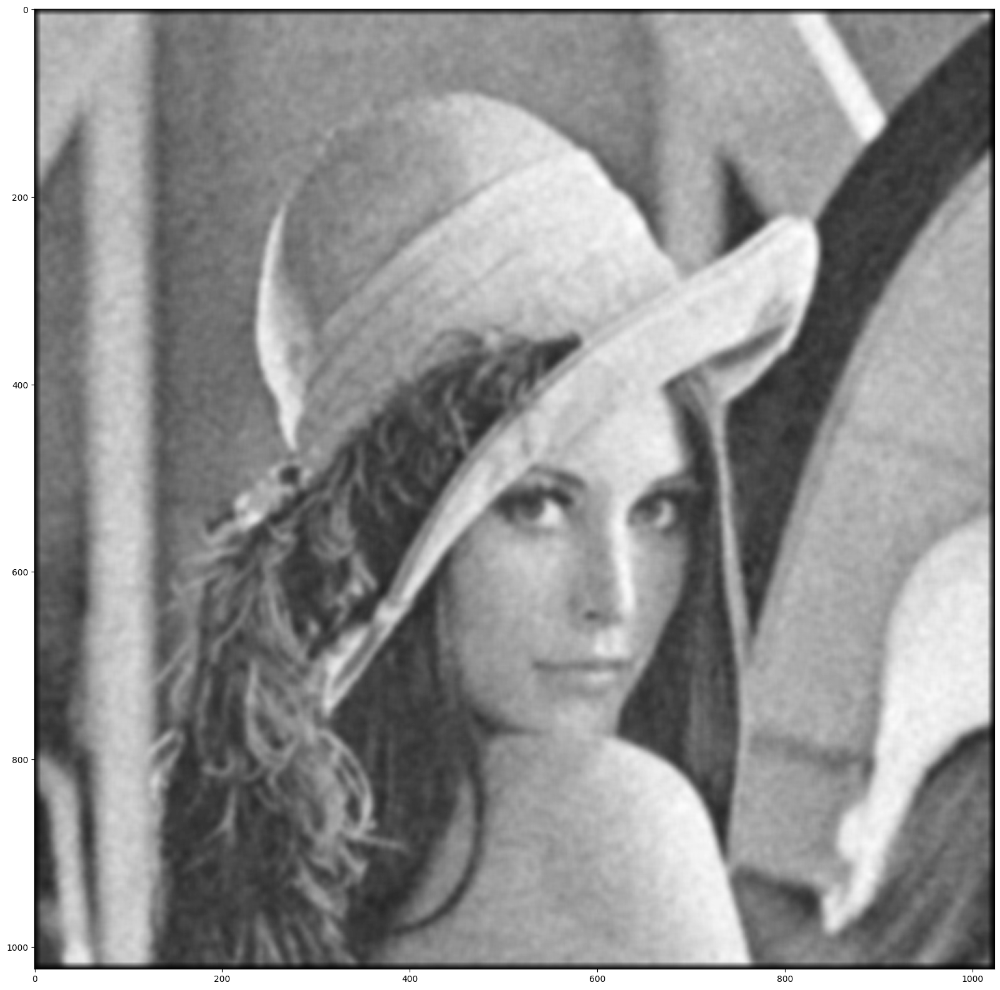

In [ ]:
#Denoise the lena image with sliding windows
window_size=8
n_components=20
step=1
denoised_image3 = remove_noise_sw(noisy_image, sigma, window_size, n_components, step)
plt.figure(figsize=(20,20))
plt.imshow(denoised_image3, cmap='gray')
plt.show()

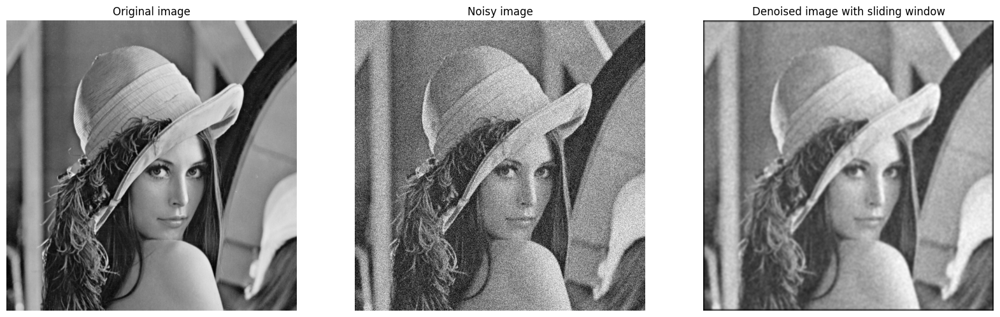

In [ ]:
#Plot original, noisy and denoised images
plt.figure(figsize=(20, 20))


plt.subplot(1, 3, 1)
plt.imshow(image_gris, cmap='gray')
plt.title("Original image")
plt.axis("off")


plt.subplot(1, 3, 2)
plt.imshow(noisy_image, cmap='gray')
plt.title("Noisy image")
plt.axis("off")


plt.subplot(1, 3, 3)
plt.imshow(denoised_image3, cmap='gray')
plt.title("Denoised image with sliding window")
plt.axis("off")

plt.show()

## Heartbeat Removal (ECG) from MEG

Opening raw data file /Users/kelthoumkerboua/mne_data/MNE-sample-data/MEG/sample/sample_audvis_filt-0-40_raw.fif...
    Read a total of 4 projection items:
        PCA-v1 (1 x 102)  idle
        PCA-v2 (1 x 102)  idle
        PCA-v3 (1 x 102)  idle
        Average EEG reference (1 x 60)  idle
    Range : 6450 ... 48149 =     42.956 ...   320.665 secs
Ready.
Reading 0 ... 9009  =      0.000 ...    59.999 secs...
Using matplotlib as 2D backend.


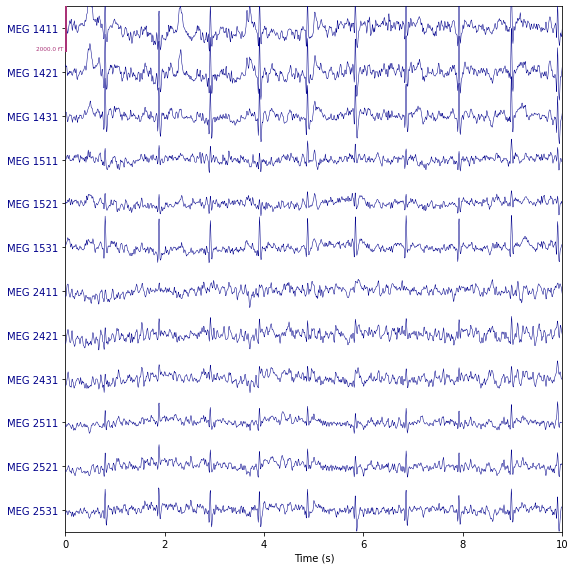

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 497 samples (3.310 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 162 out of 162 | elapsed:    0.0s finished


In [ ]:
#Import MEG signals with artefacts and heartbeats

sample_data_folder = mne.datasets.sample.data_path()
sample_data_raw_file = os.path.join(sample_data_folder, "MEG", "sample", "sample_audvis_filt-0-40_raw.fif")
raw = mne.io.read_raw_fif(sample_data_raw_file)

# Here we'll crop to 60 seconds and drop gradiometer channels for speed
raw.crop(tmax=60.0).pick(picks=["mag", "eeg", "stim", "eog"])
raw.load_data()

#we select the MEG with heartbeats and artefacts
regexp = r"(MEG [12][45][123]1)"
artifact_picks = mne.pick_channels_regexp(raw.ch_names, regexp=regexp)
raw.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

#filtering
raw = raw.copy().filter(l_freq=1.0, h_freq=None)
meg_data = raw.get_data(picks=artifact_picks)

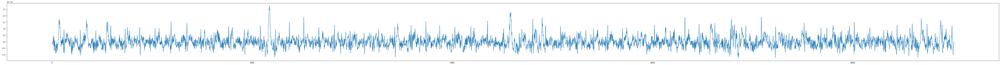

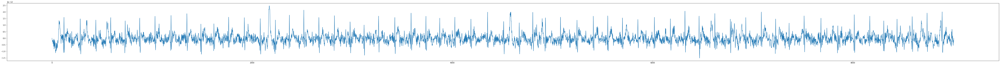

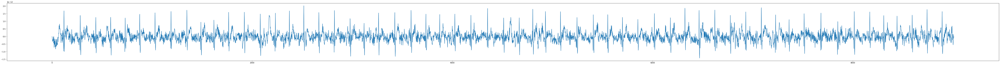

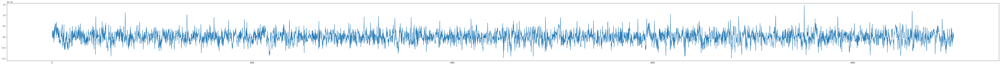

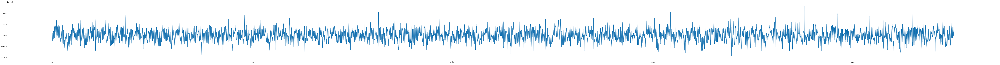

...

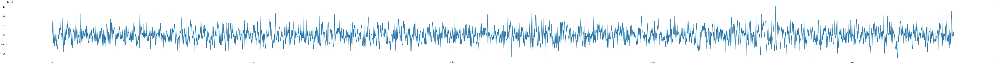

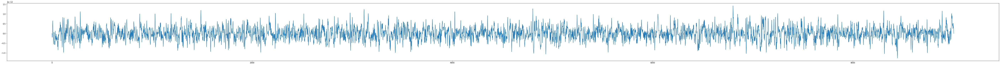

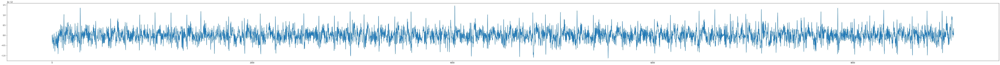

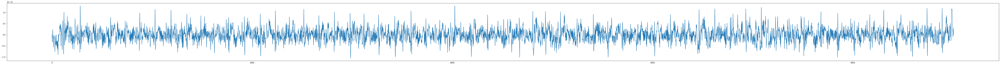

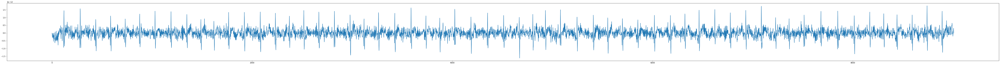

In [ ]:
#Plot the MEG signals (we can see the obvious heartbeats)
for meg in meg_data:
    plt.figure(figsize=(100, 6))
    plt.plot(meg[:])
    plt.show()

In [ ]:
#Estimation of mixing matrix ans sources with FastICA
W,S, _, _ = FastICA(np.array(meg_data), 3, function_g="tanh", tol=10e-4, max_iter=200)

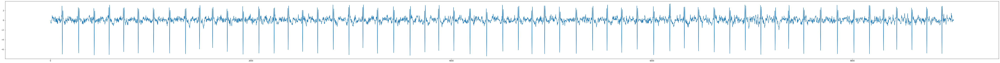

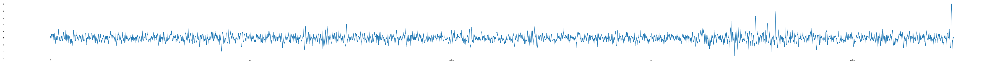

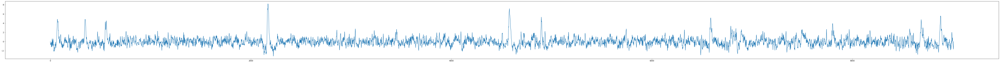

In [ ]:
#Plot the sources (first one correspond to heartbeats - ECG)
for s in S:
    plt.figure(figsize=(100, 6))
    plt.plot(s[:])
    plt.show()

## Face recognition : ICA + SVM

Article: Face recognition using independent component analysis and support vector machines
O. Deniz , M. Castrillon, M. Hernandez

Dataset: http://www.cad.zju.edu.cn/home/dengcai/Data/FaceData.html

In [ ]:
#Import dataset YaleB_32x32
data= loadmat('YaleB_32x32.mat')
X=data['fea']
y=data['gnd']

In [ ]:
print('Here we use the extended yale dataset which have',X.shape[0],'facial images')
print('Each subject have different facial expression')
print('For exemple for the first subject, we have',np.where(y==1)[0].shape[0],'facial images')

Here we use the extended yale dataset which have 2414 facial images
Each subject have different facial expression
For exemple for the first subject, we have 64 facial images


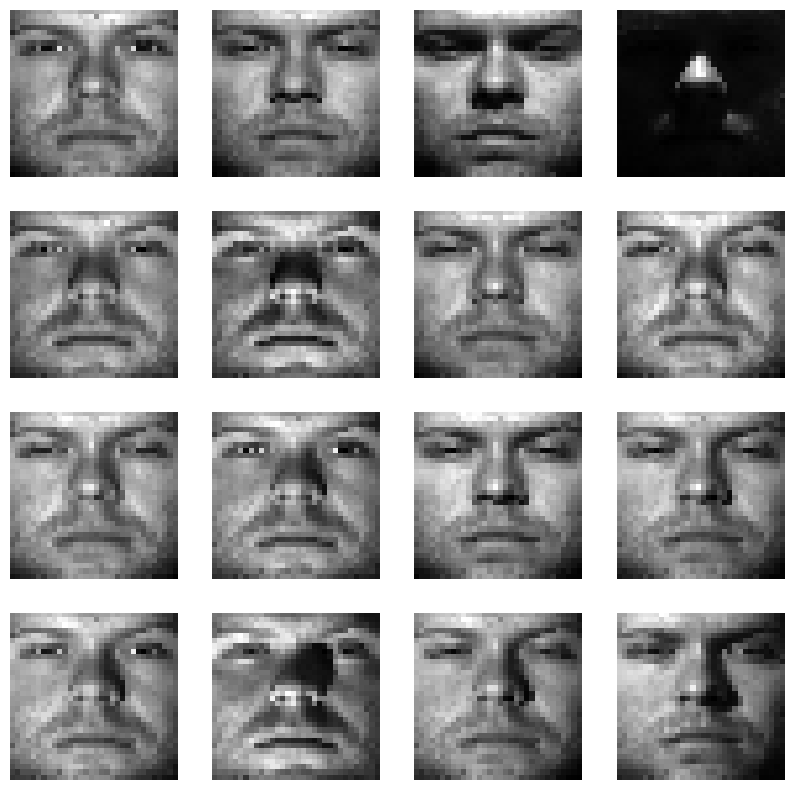

In [ ]:
#Plot few facial images of the same individual
examples=X[:16,:]
cpt=0
fig, axs = plt.subplots(4, 4, figsize=(10,10))
for i in range(4):
    for j in range(4):
        axs[i, j].imshow(examples[cpt,:].reshape(32,32).T,cmap='gray')
        axs[i, j].axis("off")
        cpt+=1

In [ ]:
#let's split our data into training and test sample.
def train_test_split(X,y,percent_train):
    """
    Returns the data and target separated into training and testing set

            Parameters:
                X (array): data
                y (array): target
                percent_train (float): percentage of data in the training set
            Returns:
                X_train (array)
                y_train (array)
                X_test (array)
                y_test (array)

    """

    N=X.shape[0]
    indices = np.arange(N)
    np.random.shuffle(indices)
    X_shuffled=X[indices,:]
    y_shuffled=y[indices]
    t_size=int(percent_train*N)
    X_train=X_shuffled[:t_size,:]
    y_train=y_shuffled[:t_size]
    X_test=X_shuffled[t_size:,:]
    y_test=y_shuffled[t_size:]

    return X_train, X_test, y_train, y_test

def histogram_equalization(image):
    """
    Returns the image with an equalized histogram

            Parameters:
                image (array)
            Returns:
                equalized_image (array)
    """
    # Calculate cumulative histogram
    histogram, bins = np.histogram(image, 256, [0, 256])
    cumulative_histogram = histogram.cumsum()
    # Normalize cumulative histogram to be between 0 and 255
    normalized_cumulative_histogram = (cumulative_histogram * 255 / cumulative_histogram[-1]).astype(np.uint8)
    # Apply transformation to image
    equalized_image = normalized_cumulative_histogram[image]
    return equalized_image

def accuracy(y_test,pred):
    """
    Returns the accuracy score between the truth and the prediction

            Parameters:
                y_test (array): ground truth
                pred (array): prediction
            Returns:
                accuracy (float)
    """
    acc=np.sum(y_test==pred)/y_test.shape[0]
    return acc

In [ ]:
#Split the dataset into testing and training set
X_train, X_test, y_train, y_test=train_test_split(X,y,0.8)
#Estimate sources with FastICA
_,S,_,_= FastICA(X_train, 150, function_g="tanh", tol=10e-4, max_iter=200)
#Compute the mixing matrix for the training set
W_train=X_train@np.linalg.pinv(S)
#Create a pipepline containing the SVM classifier
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
#Train the SVM with the mixing matrix coefficient to recognize the individual
clf.fit(W_train, y_train.flatten())
#Predict with SVM the individual on the training set
pred=clf.predict(W_train)
#Compute the accuracy score of the prediction
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
#Compute the mixing matrix for the testing set with the same sources
W_test=X_test@np.linalg.pinv(S)
#Predict with SVM the individual on the testing set
pred=clf.predict(W_test)
#Compute the accuracy score of the prediction
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

Training accuracy:  0.9249093733816676
Test accuracy:  0.8467908902691511


### After histogram equalization

In [ ]:
#Equalization of the histograms of all images
for i in range (X.shape[0]):
    X[i]=histogram_equalization(X[i])

#Split the dataset into testing and training set
X_train, X_test, y_train, y_test=train_test_split(X,y,0.8)
#Estimate sources with FastICA
_,S,_,_= FastICA(X_train, 150, function_g="tanh", tol=10e-4, max_iter=200)
#Compute the mixing matrix for the training set
W_train=X_train@np.linalg.pinv(S)
#Create a pipepline containing the SVM classifier
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
#Train the SVM with the mixing matrix coefficient to recognize the individual
clf.fit(W_train, y_train.flatten())
#Predict with SVM the individual on the training set
pred=clf.predict(W_train)
#Compute the accuracy score of the prediction
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
#Compute the mixing matrix for the testing set with the same sources
W_test=X_test@np.linalg.pinv(S)
#Predict with SVM the individual on the testing set
pred=clf.predict(W_test)
#Compute the accuracy score of the prediction
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

Training accuracy:  0.9963749352667012
Test accuracy:  0.9503105590062112


## Blind source separation : audio (Cocktail Party Problem)
Dataset: https://golconda.cs.nuim.ie/~barak/demo/cICA/clips-wav/

In [ ]:
#Import the audio
liste_name_audio = ['audio1.wav', 'audio2.wav','audio3.wav','audio4.wav','audio5.wav']
nb_audios=len(liste_name_audio)
liste_audio=[]
for i in range(nb_audios):
    liste_audio.append(librosa.load(liste_name_audio[i], sr=None))
rate=liste_audio[0][1]
#listen to an audio example
display(Audio(data=liste_audio[2][0], rate=rate))

In [ ]:
#3 Mixtures of 3 original audios
mix1=0.4*liste_audio[0][0]+0.8*liste_audio[1][0] + 0.5*liste_audio[2][0]
mix2=0.9*liste_audio[0][0]+0.2*liste_audio[1][0]+ 0.5*liste_audio[2][0]
mix3=0.1*liste_audio[0][0]+0.5*liste_audio[1][0]+ 0.9*liste_audio[2][0]

X=np.array([mix1,mix2,mix3])
W, S, X_white_inv, mean = FastICA(X, 3)

In [ ]:
#Listen to the original audios
print("Audio1")
display(Audio(data=liste_audio[0][0], rate=rate))
print("Audio2")
display(Audio(data=liste_audio[1][0], rate=rate))
print("Audio3")
display(Audio(data=liste_audio[2][0], rate=rate))
#Listen to the estimated sources
print("Source1")
display(Audio(data=S[0][:], rate=rate))
print("Source2")
display(Audio(data=S[1][:], rate=rate))
print("Source3")
display(Audio(data=S[2][:], rate=rate))

Audio1


Audio2


Audio3


Source1


Source2


Source3


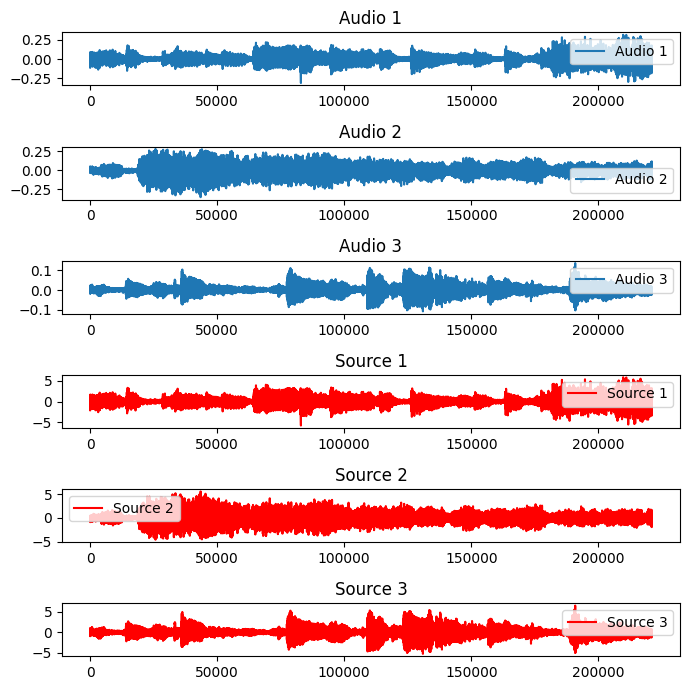

In [ ]:
# Plot the real signals and the ones estimated by FastICA
plt.figure(figsize=(7, 7))

# Plot the original audios
plt.subplot(6, 1, 1)
plt.plot(liste_audio[0][0], label='Audio 1')
plt.title('Audio 1')
plt.legend()

plt.subplot(6, 1, 2)
plt.plot(liste_audio[1][0], label='Audio 2')
plt.title('Audio 2')
plt.legend()

plt.subplot(6, 1, 3)
plt.plot(liste_audio[2][0], label='Audio 3')
plt.title('Audio 3')
plt.legend()

#Plot the estimated sources
plt.subplot(6, 1, 4)
plt.plot(S[0, :], label='Source 1', color='red')
plt.title('Source 1')
plt.legend()

plt.subplot(6, 1, 5)
plt.plot(S[1, :], label='Source 2', color='red')
plt.title('Source 2')
plt.legend()

plt.subplot(6, 1, 6)
plt.plot(S[2, :], label='Source 3', color='red')
plt.title('Source 3')
plt.legend()

plt.tight_layout()
plt.show()


## Limitations of ICA : Correlated data

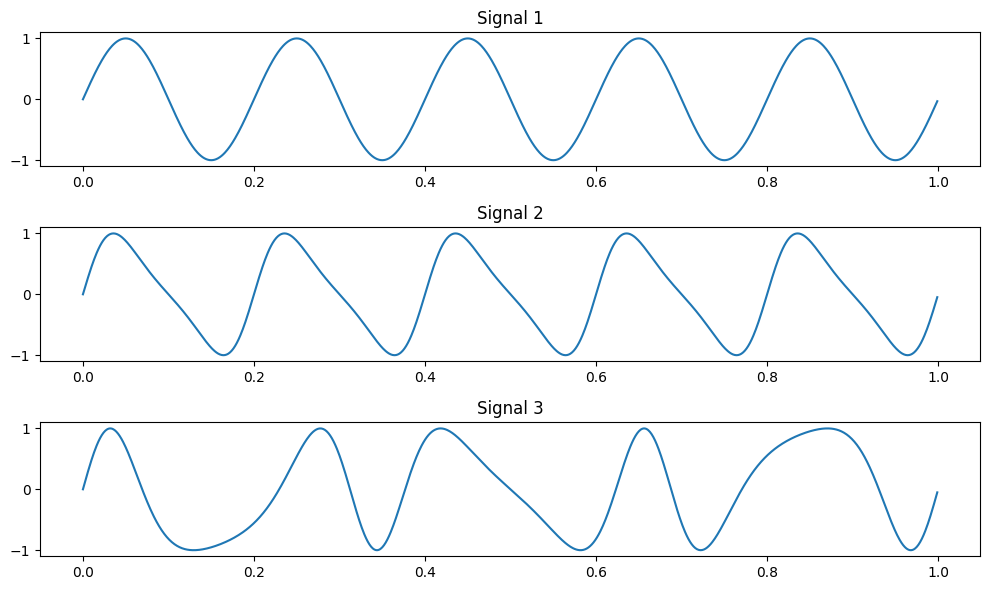

In [ ]:
num_samples = 1000
t = np.linspace(0, 1, num_samples, endpoint=False)
frequency = 5

# 3 signals correlated by non-linear dependence
signal1 = np.sin(2 * np.pi * frequency * t)
signal2 = np.sin(2 * np.pi * frequency * t + 0.5 * np.sin(2 * np.pi * 5 * t))
signal3 = np.sin(2 * np.pi * frequency * t + np.sin(2 * np.pi * 3 * t))

# plot signals
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot(t, signal1)
plt.title('Signal 1')

plt.subplot(3, 1, 2)
plt.plot(t, signal2)
plt.title('Signal 2')

plt.subplot(3, 1, 3)
plt.plot(t, signal3)
plt.title('Signal 3')

plt.tight_layout()
plt.show()


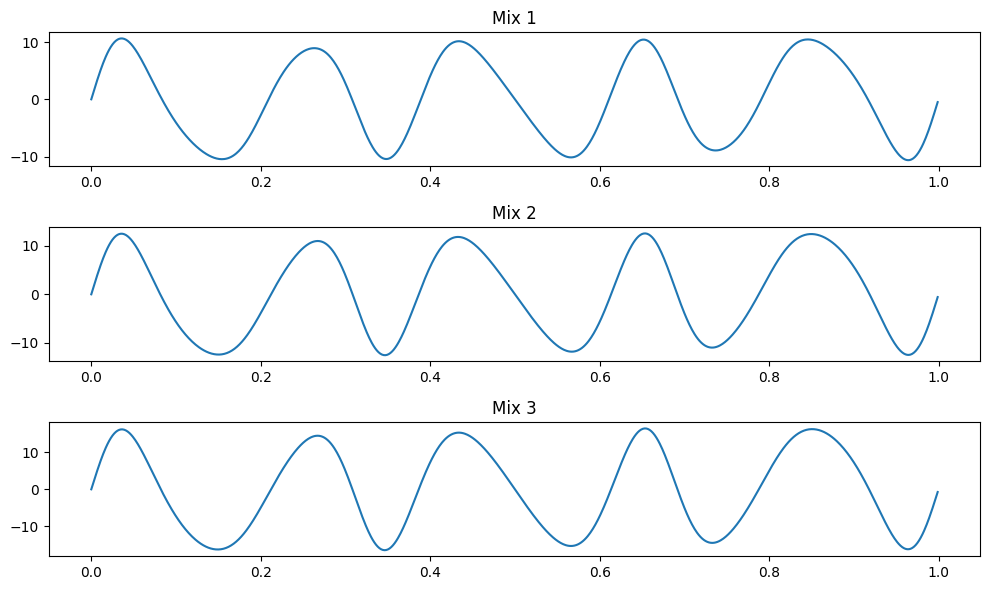

In [ ]:
#Mixture of the original signals
mixing_matrix=np.array([[3,3,5],
                        [4,2,7],
                        [6,2,9]])
sources=np.array([signal1,signal2,signal3])
mix=np.dot(mixing_matrix,sources)

#Plot mixed signals
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot(t, mix[0])
plt.title('Mix 1')

plt.subplot(3, 1, 2)
plt.plot(t, mix[1])
plt.title('Mix 2')

plt.subplot(3, 1, 3)
plt.plot(t, mix[2])
plt.title('Mix 3')

plt.tight_layout()
plt.show()

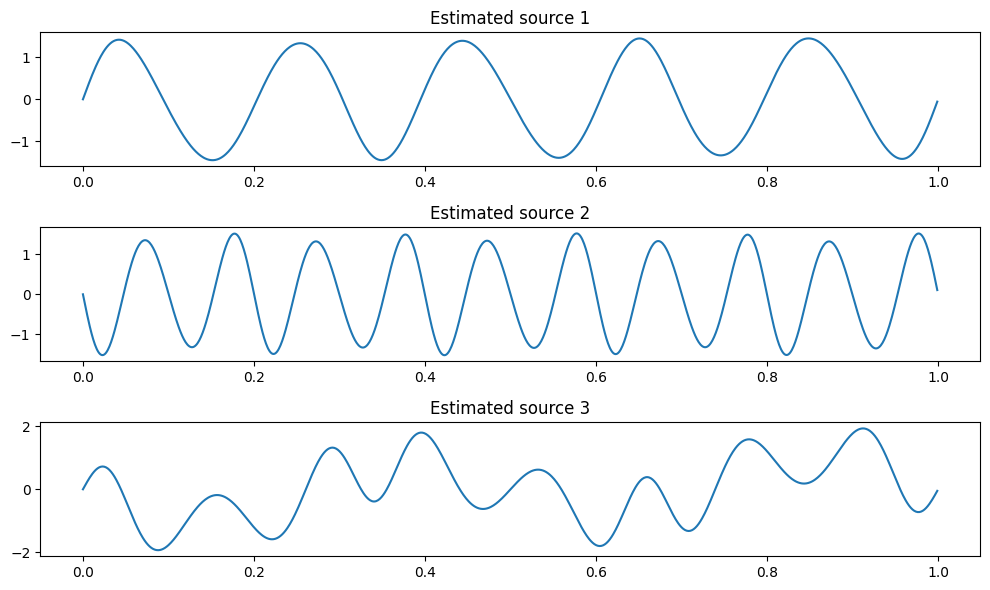

In [ ]:
#Estimation of the sources with FastICA
W, S, _, _ = FastICA(mix, 3)

#Plot estimated sources
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot(t, S[0])
plt.title('Estimated source 1')

plt.subplot(3, 1, 2)
plt.plot(t, S[1])
plt.title('Estimated source 2')

plt.subplot(3, 1, 3)
plt.plot(t, S[2])
plt.title('Estimated source 3')

plt.tight_layout()
plt.show()

## Limitations of ICA : Gaussian data

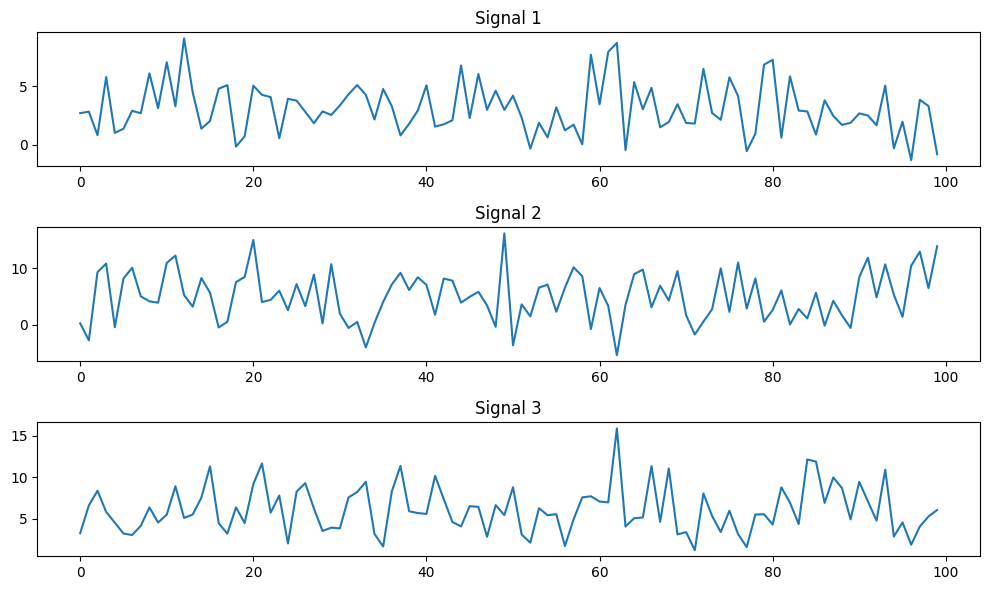

In [ ]:
num_samples = 100

# Creation 3 gaussian signals
signal1 = np.random.normal(loc=3, scale=2, size=num_samples)
signal2 = np.random.normal(loc=5, scale=4, size=num_samples)
signal3 = np.random.normal(loc=6, scale=3, size=num_samples)

# Plot signals
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot(signal1)
plt.title('Signal 1')

plt.subplot(3, 1, 2)
plt.plot(signal2)
plt.title('Signal 2')

plt.subplot(3, 1, 3)
plt.plot(signal3)
plt.title('Signal 3')

plt.tight_layout()
plt.show()

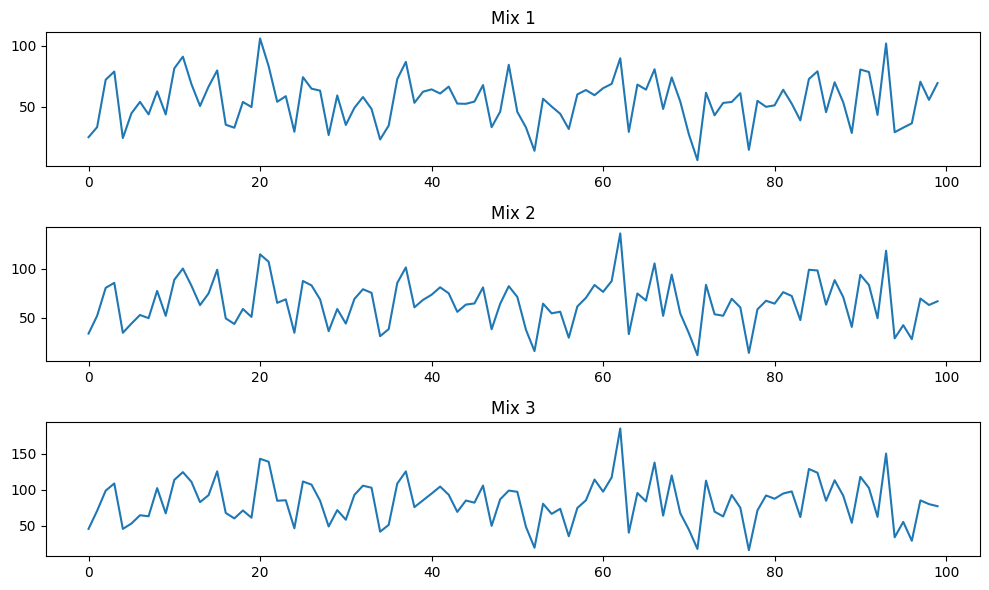

In [ ]:
# Mixture of the original signals
mixing_matrix=np.array([[3,3,5],
                        [4,2,7],
                        [6,2,9]])
sources=np.array([signal1,signal2,signal3])
mix=np.dot(mixing_matrix,sources)

# Plot mixed signals
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot( mix[0])
plt.title('Mix 1')

plt.subplot(3, 1, 2)
plt.plot(mix[1])
plt.title('Mix 2')

plt.subplot(3, 1, 3)
plt.plot (mix[2])
plt.title('Mix 3')

plt.tight_layout()
plt.show()

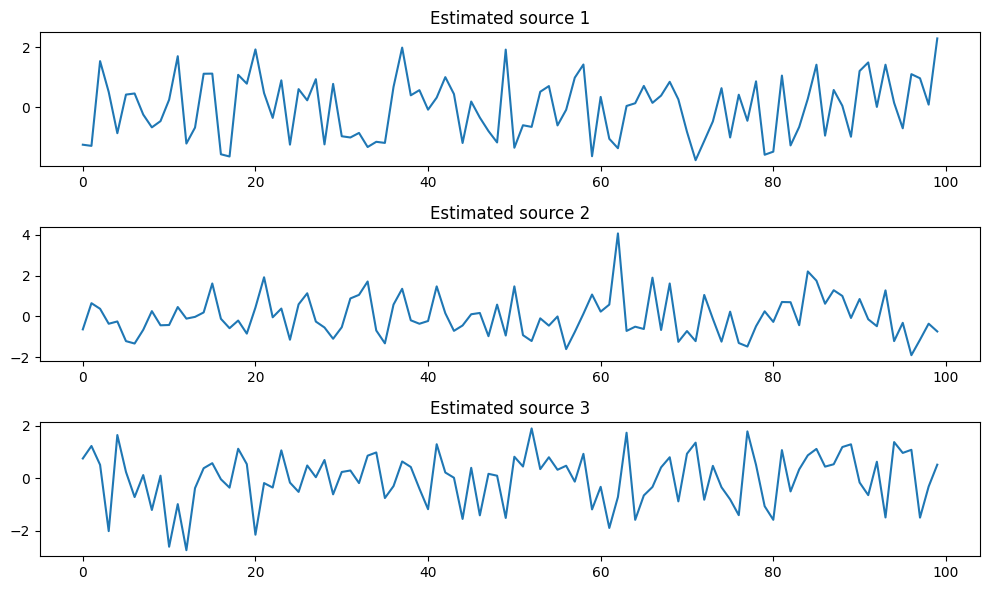

In [ ]:
#Estimation of source with FastICA
W, S, _, _ = FastICA(mix, 3)

# Plot estimated sources
plt.figure(figsize=(10, 6))
plt.subplot(3, 1, 1)
plt.plot(S[0])
plt.title('Estimated source 1')

plt.subplot(3, 1, 2)
plt.plot( S[1])
plt.title('Estimated source 2')

plt.subplot(3, 1, 3)
plt.plot( S[2])
plt.title('Estimated source 3')

plt.tight_layout()
plt.show()

## Limitations of ICA: instability  
(Case: Few data compared to the number of sources)

Example with Blind Source Separation with audio

In [ ]:
#2 Mixture of 5 audios
mix1=0.4*liste_audio[0][0]+0.8*liste_audio[1][0] + 0.1*liste_audio[2][0]+ 0.3*liste_audio[3][0] + 0.7*liste_audio[4][0]
mix2=0.9*liste_audio[0][0]+0.2*liste_audio[1][0]+ 0.9*liste_audio[2][0] + 0.8*liste_audio[3][0] + 0.2*liste_audio[4][0]

#Estimation of 5 sources with FastICA
X=np.array([mix1,mix2])
W, S, X_white_inv, mean = FastICA(X, 5)


In [ ]:
#Listen to the original audios
print("Audio1")
display(Audio(data=liste_audio[0][0], rate=rate))
print("Audio2")
display(Audio(data=liste_audio[1][0], rate=rate))
print("Audio3")
display(Audio(data=liste_audio[2][0], rate=rate))
print("Audio4")
display(Audio(data=liste_audio[3][0], rate=rate))
print("Audio5")
display(Audio(data=liste_audio[4][0], rate=rate))
#Listen to the estimated sources
print("Source1")
display(Audio(data=S[0][:], rate=rate))
print("Source2")
display(Audio(data=S[1][:], rate=rate))
print("Source3")
display(Audio(data=S[2][:], rate=rate))
print("Source4")
display(Audio(data=S[3][:], rate=rate))
print("Source5")
display(Audio(data=S[4][:], rate=rate))


Audio1


Audio2


Audio3


Audio4


Audio5


Source1


Source2


Source3


Source4


Source5


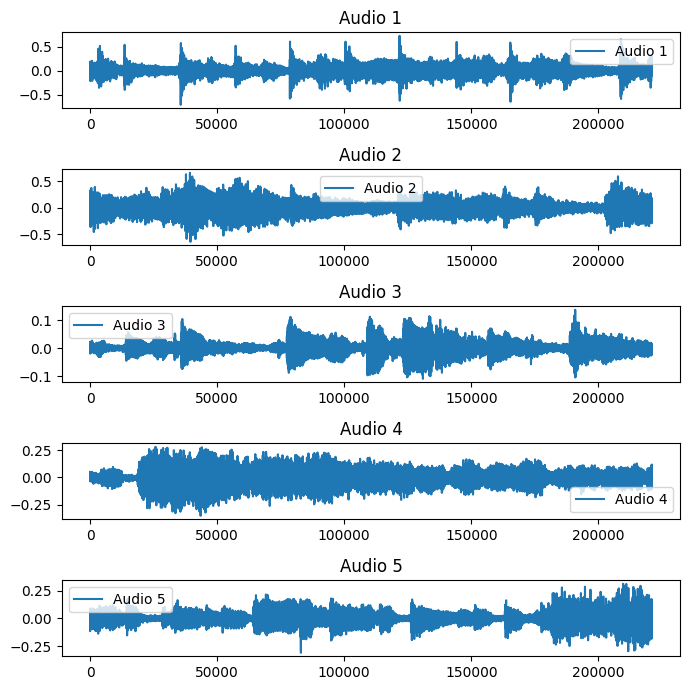

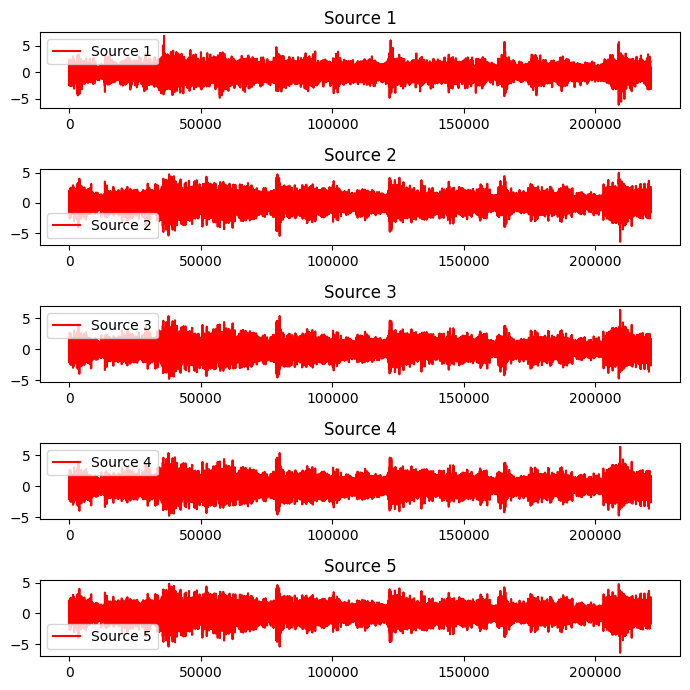

In [ ]:
# Plot the real signals and the ones estimated by FastICA
plt.figure(figsize=(7, 7))

# Plot the original audios
plt.subplot(5, 1, 1)
plt.plot(liste_audio[0][0], label='Audio 1')
plt.title('Audio 1')
plt.legend()

plt.subplot(5, 1, 2)
plt.plot(liste_audio[1][0], label='Audio 2')
plt.title('Audio 2')
plt.legend()

plt.subplot(5, 1, 3)
plt.plot(liste_audio[2][0], label='Audio 3')
plt.title('Audio 3')
plt.legend()

plt.subplot(5, 1, 4)
plt.plot(liste_audio[3][0], label='Audio 4')
plt.title('Audio 4')
plt.legend()

plt.subplot(5, 1, 5)
plt.plot(liste_audio[4][0], label='Audio 5')
plt.title('Audio 5')
plt.legend()

plt.tight_layout()
plt.show()

plt.figure(figsize=(7, 7))

# Plot the estimated sources
plt.subplot(5, 1, 1)
plt.plot(S[0, :], label='Source 1', color='red')
plt.title('Source 1')
plt.legend()

plt.subplot(5, 1, 2)
plt.plot(S[1, :], label='Source 2', color='red')
plt.title('Source 2')
plt.legend()

plt.subplot(5, 1, 3)
plt.plot(S[2, :], label='Source 3', color='red')
plt.title('Source 3')
plt.legend()

plt.subplot(5, 1, 4)
plt.plot(S[3, :], label='Source 4', color='red')
plt.title('Source 4')
plt.legend()

plt.subplot(5, 1, 5)
plt.plot(S[4, :], label='Source 5', color='red')
plt.title('Source 5')
plt.legend()

plt.tight_layout()
plt.show()

## Implementation of PCA

In [ ]:
def PCA(X):
  """
    Returns Principal Components of X

            Parameters:
                    X (array) : data of dimension nxd , n number of samples and d dimension of features

            Returns:
                    PCs (array): principal components (projection into the new space)
                    evectors (array): eigen vectors
                    evalues (array): eigen values
  """
  #Centering
  Xc=X-np.mean(X,axis=0)
  N=X.shape[0]
  #Compute covariance matrix
  cov=(Xc.T@Xc)/(N-1)
  #Compute eigenvectors and eigenvalues
  evalues,evectors=np.linalg.eig(cov)
  #Sort according to eigenvalues
  indexes=np.argsort(evalues)[::-1]
  evalues=evalues[indexes]
  evectors=evectors[:,indexes]
  #compute projection into the new space
  PCs=np.matmul(X,evectors)

  return PCs, evectors, evalues

## Comparaison with PCA: mixing matrix directions not orthogonal

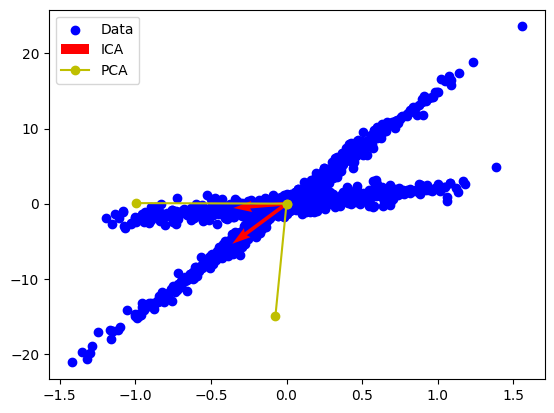

In [ ]:
# Generate points
pente1 = 2.0
pente2=15.0

num_points = 500
x_center = np.random.normal(loc=0, scale=0.5, size=num_points)
y_center = pente1 * x_center + np.random.normal(scale=0.7, size=num_points)

x_center2 = np.random.normal(loc=0, scale=0.5, size=num_points)
y_center2 = pente2 * x_center2 + np.random.normal(scale=0.7, size=num_points)


num_points_end = 100
x_end = np.linspace(-1, 1, num_points_end)
y_end = pente1 * x_end + np.random.normal(scale=0.2, size=num_points_end)

x_end2 = np.linspace(-1, 1, num_points_end)
y_end2 = pente2 * x_end2 + np.random.normal(scale=0.2, size=num_points_end)

x1 = np.concatenate([x_center, x_end,x_center2,x_end2])
x2 = np.concatenate([y_center, y_end,y_center2, y_end2 ])


#Compute sources with ICA
X=np.array([x1,x2])
W, S, _, _=FastICA(X, 2)

#Compute directions with PCA
PCs, evectors, evalues=PCA(X.T)

x_start = [0, 0]
y_start = [0, 0]


plt.scatter(x1, x2, label='Data',color='blue')
plt.quiver(x_start, y_start, W[:,0], W[:,1], angles='xy', scale_units='xy', scale=1, color=['r', 'r'],label='ICA')
#plt.quiver(x_start, y_start, evectors[:,0],evectors[:,1], angles='xy', scale_units='xy', scale=0.1, color=['y', 'y'],label='PCA')
plt.plot([0, evectors.T[0,0]], [0, 15*evectors.T[1,0]], marker='o',color='y',label='PCA')
plt.plot([0, evectors.T[0,1]], [0, evectors.T[1,1]], marker='o',color='y')

plt.legend()
plt.show()


## Comparaison with PCA: Reconstitution after reduction of dimensionality (Compression, Notion of information)


In [ ]:
#Import MNIST dataset
mnist = tf.keras.datasets.mnist
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
print(train_images.shape)
train_images=train_images.reshape((train_images.shape[0],28*28))
test_images=test_images.reshape((test_images.shape[0],28*28))
print(train_images.shape)

11490434/11490434 [==============================] - 0s 0us/step
(60000, 28, 28)
(60000, 784)


In [ ]:
#Compute principal components with PCA
PC, evectors, evalues = PCA(train_images[:2000])

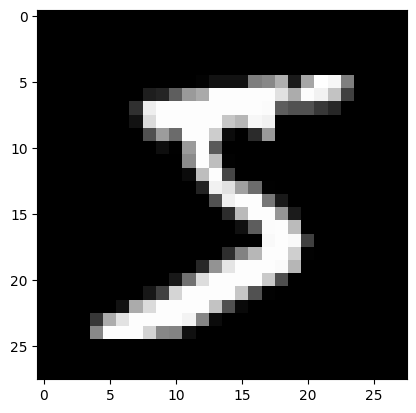

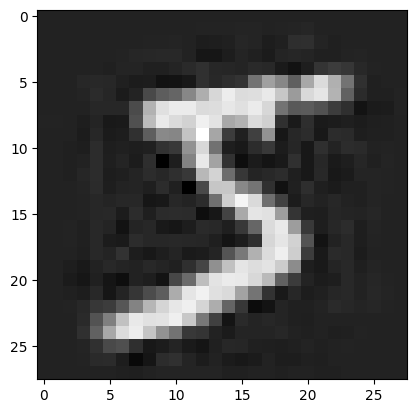

In [ ]:
#Select the 200 most important directions
n_components= 200
#Compute the projection of the training set on the new space
PC_train=train_images@evectors
#Reconstitution of the training set with only the 200 directions
train_images_uncompressed = np.real(PC_train[:,:n_components]@(evectors[:,:n_components].T))
#Plot a train image before and after compression
plt.imshow(train_images[0].reshape((28,28)),cmap='gray')
plt.show()
plt.imshow(train_images_uncompressed[0].reshape((28,28)),cmap='gray')
plt.show()

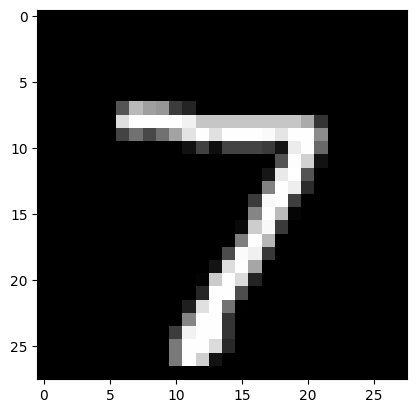

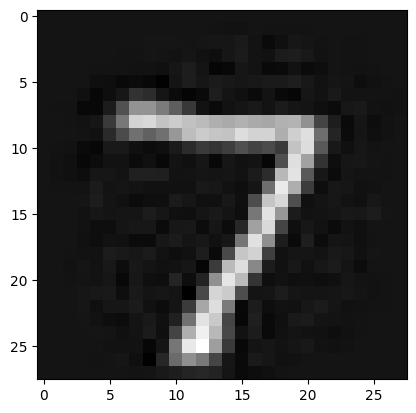

In [ ]:
#Compute the projection of the testing set in the new space
PC_test=test_images@evectors
#Reconstitution of the testing set with only the 200 components
test_images_uncompressed = np.real(PC_test[:,:n_components]@(evectors[:,:n_components].T))
#Plot a test image before and after the compression
plt.imshow(test_images[0].reshape((28,28)),cmap='gray')
plt.show()
plt.imshow(test_images_uncompressed[0].reshape((28,28)),cmap='gray')
plt.show()

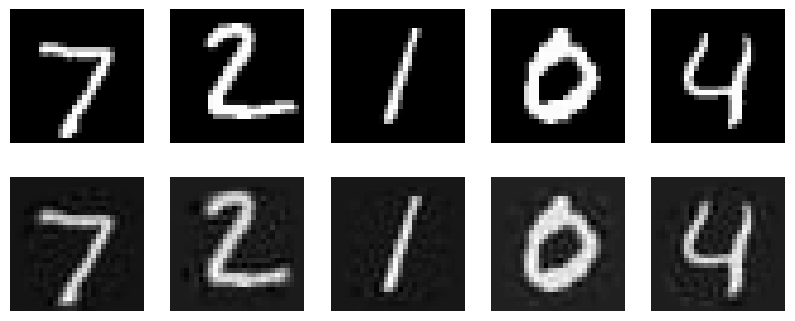

In [ ]:
fig, axs = plt.subplots(2, 5, figsize=(10,4))
for i in range (5):
  axs[0,i].imshow(test_images[i].reshape((28,28)), cmap='gray')
  axs[0,i].axis('off')
  axs[1,i].imshow(test_images_uncompressed[i].reshape((28,28)), cmap='gray')
  axs[1,i].axis('off')

In [ ]:
#Compute how much information is preserved during the compression
evectors=np.real(evectors)
tot=np.sum(evectors)
# computation of explained variance
variance_explained = evectors/tot
variance_explained_total=np.sum(variance_explained[:n_components])
print("The variance explained by the", n_components, "first principal components is : ", variance_explained_total*100, "%")

The variance explained by the 200 first principal components is :  46.67423159304547 %


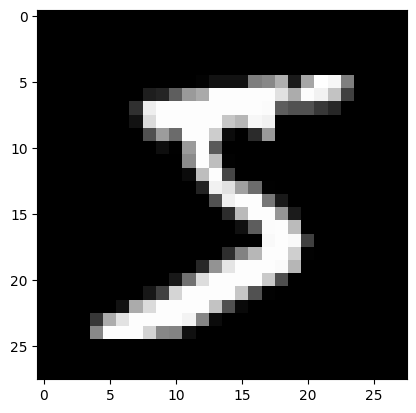

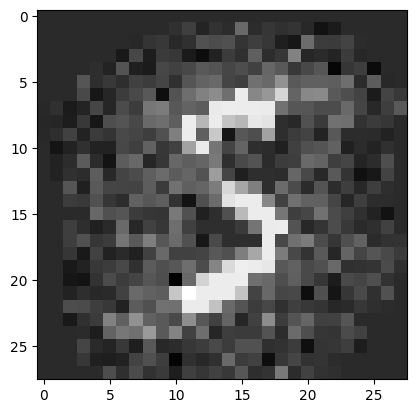

In [ ]:
#Estimation of 200 sources with FastICA
n_components=200
_,S,_,_= FastICA(train_images[:2000], n_components, function_g="tanh", tol=10e-4, max_iter=200)
#Compute the mixing matrix for the training set
W_train=train_images@np.linalg.pinv(S)
#Reconstitution as a linear combinaison of the 200 sources
train_images_uncompressed=W_train@S
#Plot a train image before and after compression
plt.imshow(train_images[0].reshape((28,28)),cmap='gray')
plt.show()
plt.imshow(train_images_uncompressed[0].reshape((28,28)),cmap='gray')
plt.show()

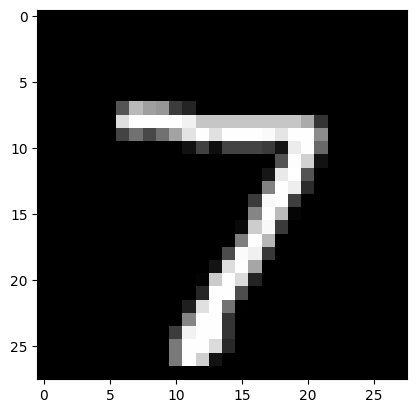

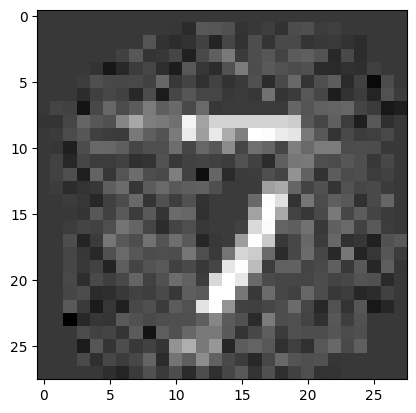

In [ ]:
#Compute the mixing matrix for the testing set
W_test=test_images@np.linalg.pinv(S)
#Reconstitution as a linear combinaison of the 200 sources
test_images_uncompressed=W_test@S
#Plot a train image before and after compression
plt.imshow(test_images[0].reshape((28,28)),cmap='gray')
plt.show()
plt.imshow(test_images_uncompressed[0].reshape((28,28)),cmap='gray')
plt.show()

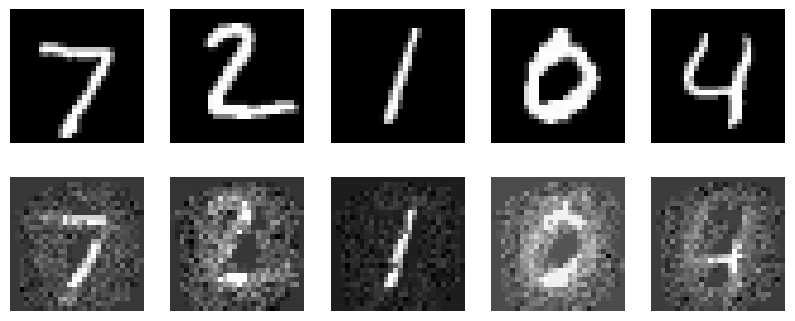

In [ ]:
fig, axs = plt.subplots(2, 5, figsize=(10,4))
for i in range (5):
  axs[0,i].imshow(test_images[i].reshape((28,28)), cmap='gray')
  axs[0,i].axis('off')
  axs[1,i].imshow(test_images_uncompressed[i].reshape((28,28)), cmap='gray')
  axs[1,i].axis('off')

## Implementation of Kernel PCA

In [ ]:
def kernel_rbf(X,gamma):
    """
    Returns value of kernel rbf at X for parameter gamma

            Parameters:
                    X (array)
                    gamma (float): parameter of kernel

            Returns:
                    PCs (array): principal components for KPCA
                    evectors (array): eigen vectors
                    evalues (array): eigen values
    """
    dist_matrix=squareform(pdist(X,'sqeuclidean'))
    return np.exp(-gamma*dist_matrix)

def KPCA(X,gamma,nb_component):
    """
    Returns Kernel Principal Components

            Parameters:
                    X (array)
                    gamma (float): parameter of kernel
                    nb_component (int): number of  selected components

            Returns:
                    PCs (array): principal components for KPCA
                    evectors (array): eigen vectors
                    evalues (array): eigen values
    """
    #Compute the kernel matrix
    K=kernel_rbf(X,gamma)
    N,_=K.shape
    #Centering the kernel
    one=np.ones((N,N))/N;
    Kc=K -one@K -K@one +one@K@one

    #Compute the eigenvectors and eigenvalues
    evalues,evectors=np.linalg.eig(Kc)
    #Sort according to the eigenvalues
    indexes=np.argsort(evalues)[::-1]
    evalues=evalues[indexes]
    evectors=evectors[:,indexes]

    #Compute th eprojection into the new space
    proj_data= Kc@ evectors[:,:nb_component]

    return proj_data, evectors,evalues




##Comparaison with Kernel PCA: Non-linear case

The original data is generated as a circle, which means that the classes are not linearly separable in the original space. PCA seeks to find a linear transformation that captures the maximum variance, which may not be optimal for non-linear data. KPCA, on the other hand, introduces a kernel that allows data to be projected into a space where class separation becomes easier. The RBF kernel is particularly useful for capturing non-linear relationships.

/usr/local/lib/python3.10/dist-packages/matplotlib/collections.py:192: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)


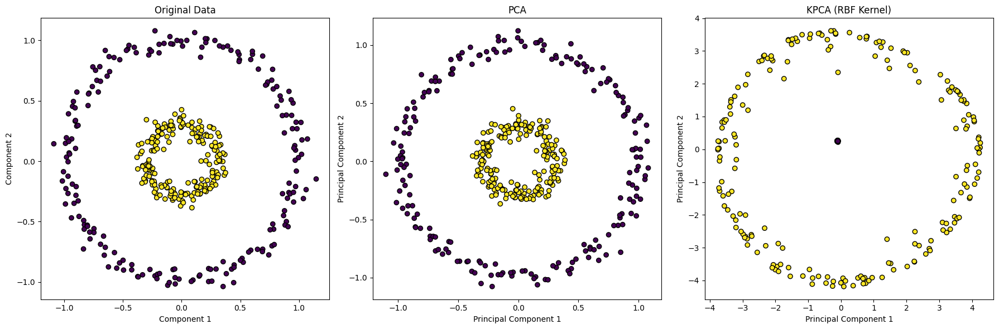

In [ ]:
#Generate data in 2 circles
X, y = make_circles(n_samples=400, factor=0.3, noise=0.05, random_state=42)

#Compute PCA projection
X_pca,_,_=PCA(X)

#compute KPCA projection
X_kpca,_,_=KPCA(X,15,2)


plt.figure(figsize=(18, 6))


plt.subplot(1, 3, 1)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap='viridis', marker='o', edgecolors='k')
plt.title('Original Data')
plt.xlabel('Component 1')
plt.ylabel('Component 2')

# Plot PCA
plt.subplot(1, 3, 2)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis', marker='o', edgecolors='k')
plt.title('PCA')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# Plot KPCA
plt.subplot(1, 3, 3)
plt.scatter(X_kpca[:, 0], X_kpca[:, 1], c=y, cmap='viridis', marker='o', edgecolors='k')
plt.title('KPCA (RBF Kernel)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.tight_layout()
plt.show()


## Comparaison PCA, KPCA, ICA : Classification after dimensionality Reduction (Concept of separability)

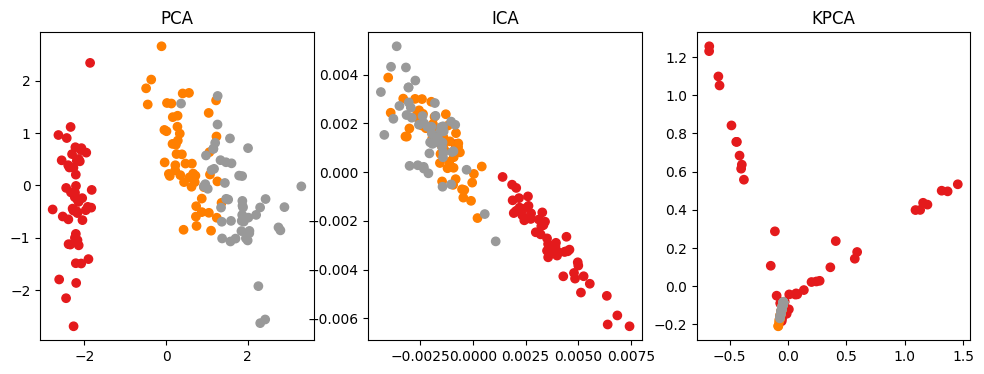

In [ ]:
#Import iris dataset
iris = datasets.load_iris()
X = iris.data
y = iris.target


X_normalized = StandardScaler().fit_transform(X)
n_components = 2

# Compute PCA projection
PCS,evec,_=PCA(X_normalized)
X_pca=X_normalized@evec[:,:n_components]

# Compute ICA projection (mixing matrix)
W,S,_,_=FastICA(X_normalized, n_components)
X_ica=W.T

# Compute KPCA projection

X_kpca,_,_=KPCA(X_normalized,15,n_components)

plt.figure(figsize=(12, 4))

# Plot PCA
plt.subplot(1, 3, 1)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap=plt.cm.Set1)
plt.title('PCA')

# Plot ICA
plt.subplot(1, 3, 2)
plt.scatter(X_ica[:, 0], X_ica[:, 1], c=y, cmap=plt.cm.Set1)
plt.title('ICA')

# Plot KPCA
plt.subplot(1, 3, 3)
plt.scatter(X_kpca[:, 0], X_kpca[:, 1], c=y, cmap=plt.cm.Set1)
plt.title('KPCA')

plt.show()


In [ ]:
#Classification with PCA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_pca,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with PCA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

#Classification with ICA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_ica,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with ICA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

#Classification with KPCA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_kpca,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with KPCA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

Classification with PCA: 
Training accuracy:  0.9619047619047619
Test accuracy:  0.8222222222222222
Classification with ICA: 
Training accuracy:  0.6857142857142857
Test accuracy:  0.7333333333333333
Classification with KPCA: 
Training accuracy:  0.5142857142857142
Test accuracy:  0.5111111111111111


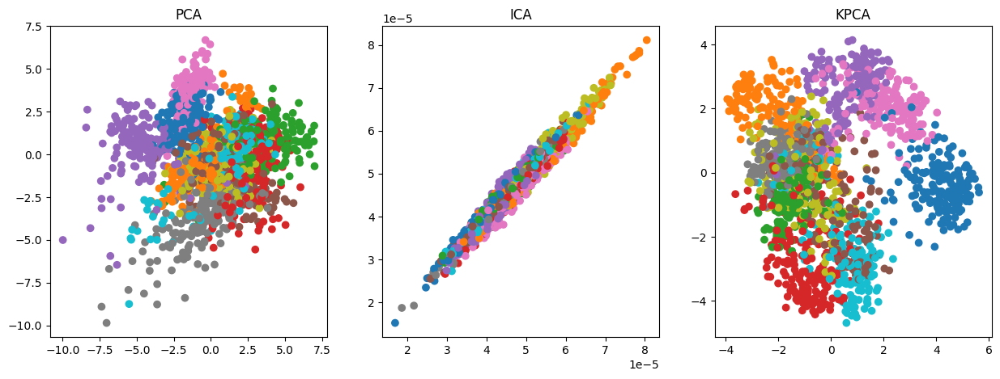

In [ ]:
#Import digits dataset
digits = load_digits()
X = digits.data
y = digits.target


X_normalized = StandardScaler().fit_transform(X)
n_components = 2

# Compute PCA projection
PCS,evec,_=PCA(X_normalized)
X_pca=X_normalized@evec[:,:n_components]

# Compute ICA projection (mixing matrix)
W,S,_,_ = FastICA(X ,n_components)
X_ica=W.T

# Compute KPCA projection
X_kpca,_,_ = KPCA(X_normalized,0.02,n_components)


plt.figure(figsize=(15, 5))

# Plot PCA projection
plt.subplot(1, 3, 1)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap=plt.cm.tab10)
plt.title('PCA')



# Plot KPCA projection
plt.subplot(1, 3, 3)
plt.scatter(X_kpca[:, 0], X_kpca[:, 1], c=y, cmap=plt.cm.tab10)
plt.title('KPCA')

# Plot ICA projection
plt.subplot(1, 3, 2)
plt.scatter(X_ica[:, 0], X_ica[:, 1], c=y, cmap=plt.cm.tab10)
plt.title('ICA')

plt.show()

In [ ]:
#Classification with PCA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_pca,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with PCA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

#Classification with ICA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_ica,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with ICA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

#Classification with KPCA projection and SVM
X_train, X_test, y_train, y_test= train_test_split(X_kpca,y,0.7)
clf=make_pipeline(StandardScaler(), SVC(gamma='auto',kernel='rbf'))
clf.fit(X_train, y_train.flatten())
pred=clf.predict(X_train)
print("Classification with KPCA: ")
print("Training accuracy: ", accuracy(y_train.flatten(),pred))
pred=clf.predict(X_test)
print("Test accuracy: ", accuracy(y_test.flatten(),pred))

Classification with PCA: 
Training accuracy:  0.5958631662688942
Test accuracy:  0.5851851851851851
Classification with ICA: 
Training accuracy:  0.2386634844868735
Test accuracy:  0.19814814814814816
Classification with KPCA: 
Training accuracy:  0.6340493237867939
Test accuracy:  0.6148148148148148
